In [ ]:
import pandas as pd
import ast

df = pd.read_csv('MDS project/full_text_with_gpt_embeddings.csv')

df = df.dropna(subset=['cleaned text'])

df["gpt_embedding"] = df["gpt_embedding"].apply(lambda x: ast.literal_eval(x))

df

,Main panel_x,Unit of assessment number_x,Title,cleaned text,5 Class Labels,Summary impact type,9 Class Labels,Variance,sentence tokenized,word tokenized,string,3 Class Labels,gpt_embedding
0,A,6.0,Agricultural Robotics: Data Driven Technologie...,UoL’s innovative agri-food research has underp...,3,Technological,6,0.666000,"[['uols', 'innovative', 'agrifood', 'research'...","['uols', 'innovative', 'agrifood', 'research',...",uols innovative agrifood research underpin ser...,1,"[0.02778695523738861, 0.03656265512108803, -0...."
1,A,4.0,Alleviating the societal and economic burden o...,The Cambridge University research has had a si...,4,Health,7,0.444111,"[['cambridge', 'university', 'research', 'sign...","['cambridge', 'university', 'research', 'signi...",cambridge university research significant farr...,1,"[0.025444526225328445, 0.022561024874448776, -..."
2,A,6.0,Changes in policy for the control of bovine tu...,Bovine tuberculosis is a substantial economic ...,4,Environmental,7,0.450000,"[['bovine', 'tuberculosis', 'substantial', 'ec...","['bovine', 'tuberculosis', 'substantial', 'eco...",bovine tuberculosis substantial economic anima...,1,"[0.019888462498784065, 0.023631425574421883, -..."
3,A,2.0,Empowering personalised discussion and advance...,Advance decisions about resuscitation are a gl...,4,Health,7,0.358124,"[['advance', 'decision', 'resuscitation', 'glo...","['advance', 'decision', 'resuscitation', 'glob...",advance decision resuscitation global health e...,1,"[0.02248365618288517, -0.008871562778949738, -..."
4,A,5.0,Improving patient outcomes and treatment guide...,Professor Irving's research has been instrumen...,3,Health,6,0.454204,"[['professor', 'irvings', 'research', 'instrum...","['professor', 'irvings', 'research', 'instrume...",professor irvings research instrumental set na...,1,"[-0.002802259288728237, 0.043551620095968246, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1345,A,4.0,Transforming the use of Arterial Spin Labellin...,The Arterial Spin Labelling In Dementia (AID) ...,4,Technological,7,0.655264,"[['arterial', 'spin', 'labelling', 'dementia',...","['arterial', 'spin', 'labelling', 'dementia', ...",arterial spin labelling dementia aid programme...,1,"[0.02346917614340782, 0.010281388647854328, -0..."
1346,A,5.0,Transforming therapeutic outcomes of fatal Duc...,Research undertaken at RHUL led to the develop...,3,Health,7,0.222111,"[['research', 'undertaken', 'rhul', 'lead', 'd...","['research', 'undertaken', 'rhul', 'lead', 'de...",research undertaken rhul lead development gene...,1,"[0.0031257031951099634, 0.024351993575692177, ..."
1347,A,3.0,Transforming Treatment for Obstructive Sleep A...,Obstructive sleep apnoea (OSA) is one of the m...,3,Health,7,0.234375,"[['obstructive', 'sleep', 'apnoea', 'osa', 'on...","['obstructive', 'sleep', 'apnoea', 'osa', 'one...",obstructive sleep apnoea osa one common respir...,1,"[0.028280194848775864, 0.0345553383231163, -0...."
1348,A,1.0,Transforming vaccine policy for pneumococcal d...,It was the result of Professor Lim's expertise...,3,Health,7,0.334111,"[['result', 'professor', 'lims', 'expertise', ...","['result', 'professor', 'lims', 'expertise', '...",result professor lims expertise field large sp...,1,"[0.012853133492171764, 0.03865852206945419, -0..."


In [ ]:
import pandas as pd
import tensorflow
from nltk.tokenize import regexp_tokenize, sent_tokenize
from nltk import pos_tag_sents
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from string import punctuation
from tensorflow.keras.preprocessing.sequence import pad_sequences
from sklearn.model_selection import train_test_split
import numpy as np
import re
import time
from sklearn.feature_extraction.text import TfidfVectorizer
from gensim.models import KeyedVectors
from gensim.models import Word2Vec
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
from sklearn.pipeline import Pipeline
from sklearn.decomposition import TruncatedSVD
from sklearn.neighbors import KNeighborsClassifier
from tqdm import tqdm
from sklearn.model_selection import GridSearchCV
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, Conv1D, MaxPooling1D, Flatten, Dense
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import to_categorical

import nltk
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
nltk.download('stopwords')


import pandas as pd
import numpy as np
import random
import tensorflow as tf
import torch

# Set the seed for reproducibility
SEED = 42

# Set seed for Python random module
random.seed(SEED)

# Set seed for NumPy
np.random.seed(SEED)

# Set seed for TensorFlow
tf.random.set_seed(SEED)

# Set seed for PyTorch
torch.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)

# For deterministic behavior in cuDNN
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False


#Dictionary of contractions for replacement

contractions = {
          "ain't": "am not",
          "aren't": "are not",
          "can't": "cannot",
          "can't've": "cannot have",
          "'cause": "because",
          "could've": "could have",
          "couldn't": "could not",
          "couldn't've": "could not have",
          "didn't": "did not",
          "doesn't": "does not",
          "don't": "do not",
          "hadn't": "had not",
          "hadn't've": "had not have",
          "hasn't": "has not",
          "haven't": "have not",
          "he'd": "he would",
          "he'd've": "he would have",
          "he'll": "he will",
          "he'll've": "he will have",
          "he's": "he is",
          "how'd": "how did",
          "how'd'y": "how do you",
          "how'll": "how will",
          "how's": "how is",
          "i'd": "i would",
          "i'd've": "i would have",
          "i'll": "i will",
          "i'll've": "i will have",
          "i'm": "i am",
          "i've": "i have",
          "isn't": "is not",
          "it'd": "it had",
          "it'd've": "it would have",
          "it'll": "it will",
          "it'll've": "it will have",
          "it's": "it is",
          "let's": "let us",
          "ma'am": "madam",
          "mayn't": "may not",
          "might've": "might have",
          "mightn't": "might not",
          "mightn't've": "might not have",
          "must've": "must have",
          "mustn't": "must not",
          "mustn't've": "must not have",
          "needn't": "need not",
          "needn't've": "need not have",
          "o'clock": "of the clock",
          "oughtn't": "ought not",
          "oughtn't've": "ought not have",
          "shan't": "shall not",
          "sha'n't": "shall not",
          "shan't've": "shall not have",
          "she'd": "she would",
          "she'd've": "she would have",
          "she'll": "she will",
          "she'll've": "she will have",
          "she's": "she is",
          "should've": "should have",
          "shouldn't": "should not",
          "shouldn't've": "should not have",
          "so've": "so have",
          "so's": "so is",
          "that'd": "that would",
          "that'd've": "that would have",
          "that's": "that is",
          "there'd": "there had",
          "there'd've": "there would have",
          "there's": "there is",
          "they'd": "they would",
          "they'd've": "they would have",
          "they'll": "they will",
          "they'll've": "they will have",
          "they're": "they are",
          "they've": "they have",
          "to've": "to have",
          "wasn't": "was not",
          "we'd": "we had",
          "we'd've": "we would have",
          "we'll": "we will",
          "we'll've": "we will have",
          "we're": "we are",
          "we've": "we have",
          "weren't": "were not",
          "what'll": "what will",
          "what'll've": "what will have",
          "what're": "what are",
          "what's": "what is",
          "what've": "what have",
          "when's": "when is",
          "when've": "when have",
          "where'd": "where did",
          "where's": "where is",
          "where've": "where have",
          "who'll": "who will",
          "who'll've": "who will have",
          "who's": "who is",
          "who've": "who have",
          "why's": "why is",
          "why've": "why have",
          "will've": "will have",
          "won't": "will not",
          "won't've": "will not have",
          "would've": "would have",
          "wouldn't": "would not",
          "wouldn't've": "would not have",
          "y'all": "you all",
          "y'alls": "you alls",
          "y'all'd": "you all would",
          "y'all'd've": "you all would have",
          "y'all're": "you all are",
          "y'all've": "you all have",
          "you'd": "you had",
          "you'd've": "you would have",
          "you'll": "you you will",
          "you'll've": "you you will have",
          "you're": "you are",
          "you've": "you have"
            }

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:

import string

from nltk.stem import WordNetLemmatizer
wnl = WordNetLemmatizer()
stopwords_set = set(stopwords.words('english'))
punctuation_set = set(string.punctuation)


def penn_to_wordnet(penn_pos_tag):
    """
    Function to convert Penn Treebank part-of-speech tags to corresponding WordNet tags.
    """
    tag_dictionary = {
        'NN': 'n', 'NNS': 'n', 'NNP': 'n', 'NNPS': 'n',
        'JJ': 'a', 'JJR': 'a', 'JJS': 'a',
        'VB': 'v', 'VBD': 'v', 'VBG': 'v', 'VBN': 'v', 'VBP': 'v', 'VBZ': 'v',
        'RB': 'r', 'RBR': 'r', 'RBS': 'r',
        'MD': 'v'
    }
    return tag_dictionary.get(penn_pos_tag[:2], "n")

def preprocess_text(text):
    """
    Function to preprocess text: lowercasing, removing punctuation, expanding contractions, lemmatization, etc.
    """
    if not isinstance(text, str):
        return ""

    text = text.lower()

    text = re.sub(r'(.)\1{2,}', r'\1', text)

    text = re.sub(r"http\S+", " ", text)

    text = re.sub("<.*?>", "", text)

    text = re.sub(r'\.(?![ .])', '. ', text)

    text = re.sub(r'<br />', ' ', text)

    text = re.sub(r'\d+', '', text)

    text = re.sub(r'\b(?=.*\d)(?=.*[a-zA-Z]).*?\b', '', text)

    text = re.sub(r'\b\d+(\.\d+)?', '', text)

    tokenized_sentences = [regexp_tokenize(sent, pattern="\s+", gaps=True) for sent in sent_tokenize(text)]

    new_sentences = []

    for sentences in pos_tag_sents(tokenized_sentences):
        new_sentence = []
        for word, tag in sentences:
            if word not in punctuation_set and word not in stopwords_set:
                if word in contractions:
                    words = contractions[word].split(" ")
                    new_sentence.extend(words)
                else:
                    wordnet_pos = penn_to_wordnet(tag)
                    lemmatized_word = wnl.lemmatize(word, pos=wordnet_pos)
                    lemmatized_word = re.sub(r'[^\w\s]', '', lemmatized_word)

                    if lemmatized_word and len(lemmatized_word) > 2:
                        new_sentence.append(lemmatized_word)

        if new_sentence:
            new_sentences.append(new_sentence)

    return new_sentences


In [ ]:
from tqdm.notebook import tqdm
tqdm.pandas()


new_df = df[["Main panel_x","Unit of assessment number_x","Title","cleaned text","5 Class Labels","Summary impact type","9 Class Labels", "Variance"]]

new_df = new_df[new_df["Main panel_x"] == "A"]


new_df["sentence tokenized"] = new_df["cleaned text"].apply(lambda x: preprocess_text(x))


NameError: name 'preprocess_text' is not defined

In [ ]:
def flatten(sents_tokenized):
    return [word for sentence in sents_tokenized for word in sentence]

def tokens_to_string(tokens):
    return ' '.join(tokens)


new_df["word tokenized"] = new_df["sentence tokenized"].apply(lambda x: flatten(x))

new_df["string"] = new_df["word tokenized"].apply(lambda x: tokens_to_string(x))


# In[7]:
#

def map_labels(label):
    if label in [0, 1, 2, 3, 4, 5]:
        return 0
    elif label in [6, 7]:
        return 1
    elif label == 8:
        return 2
    else:
        return label

new_df['3 Class Labels'] = new_df['9 Class Labels'].apply(map_labels)


In [ ]:
new_df

,Main panel_x,Unit of assessment number_x,Title,cleaned text,5 Class Labels,Summary impact type,9 Class Labels,Variance,sentence tokenized,word tokenized,string,3 Class Labels
0,A,6.0,Agricultural Robotics: Data Driven Technologie...,UoL’s innovative agri-food research has underp...,3,Technological,6,0.666000,"[[uols, innovative, agrifood, research, underp...","[uols, innovative, agrifood, research, underpi...",uols innovative agrifood research underpin ser...,1
1,A,4.0,Alleviating the societal and economic burden o...,The Cambridge University research has had a si...,4,Health,7,0.444111,"[[cambridge, university, research, significant...","[cambridge, university, research, significant,...",cambridge university research significant farr...,1
2,A,6.0,Changes in policy for the control of bovine tu...,Bovine tuberculosis is a substantial economic ...,4,Environmental,7,0.450000,"[[bovine, tuberculosis, substantial, economic,...","[bovine, tuberculosis, substantial, economic, ...",bovine tuberculosis substantial economic anima...,1
3,A,2.0,Empowering personalised discussion and advance...,Advance decisions about resuscitation are a gl...,4,Health,7,0.358124,"[[advance, decision, resuscitation, global, he...","[advance, decision, resuscitation, global, hea...",advance decision resuscitation global health e...,1
4,A,5.0,Improving patient outcomes and treatment guide...,Professor Irving's research has been instrumen...,3,Health,6,0.454204,"[[professor, irvings, research, instrumental, ...","[professor, irvings, research, instrumental, s...",professor irvings research instrumental set na...,1
5,A,6.0,Improving the health of flat-faced dog breeds,BOAS presents a significant health and welfare...,4,Technological,7,0.450000,"[[boa, present, significant, health, welfare, ...","[boa, present, significant, health, welfare, i...",boa present significant health welfare issue f...,1
6,A,6.0,Novel diagnostics informing pig herd managemen...,"G. parasuis is endemic worldwide, but outbreak...",4,Technological,7,0.450000,"[[parasuis, endemic, worldwide, outbreak, naiv...","[parasuis, endemic, worldwide, outbreak, naive...",parasuis endemic worldwide outbreak naive popu...,1
7,A,5.0,Protecting global food production and woodland...,The models for spore dispersal of wheat rust h...,4,Environmental,7,0.231504,"[[model, spore, dispersal, wheat, rust, use, p...","[model, spore, dispersal, wheat, rust, use, pr...",model spore dispersal wheat rust use produce e...,1
8,A,5.0,"""Superdosing"" with phytase: improving animal f...",Details of the impact Brearley's research has ...,3,Technological,7,0.409111,"[[detail, impact, brearleys, research, impact,...","[detail, impact, brearleys, research, impact, ...",detail impact brearleys research impact commer...,1
9,A,3.0,?One-stop? Diagnosis: Vastly Improved Prognosi...,Queen Mary has worked with the Behçet’s Syndro...,3,Health,7,0.234375,"[[queen, mary, work, behçets, syndrome, centre...","[queen, mary, work, behçets, syndrome, centre,...",queen mary work behçets syndrome centre excell...,1


In [ ]:
import sys
sys.modules['openai'] = None

import pandas as pd
import numpy as np
from sentence_transformers import SentenceTransformer
from umap import UMAP
from hdbscan import HDBSCAN
from bertopic import BERTopic
from bertopic.vectorizers import ClassTfidfTransformer
from collections import Counter
from transformers import LongformerTokenizer, LongformerModel
import torch
import random
from sklearn.metrics import silhouette_score

random.seed(42)
np.random.seed(42)
torch.manual_seed(42)

if torch.cuda.is_available():
    torch.cuda.manual_seed_all(42)


docs = df["string"].tolist()

embeddings = np.array(df["gpt_embedding"].tolist())

def run_bert_topic(docs, embedidngs, n_neighbors, n_components, min_cluster_size):

  umap_model = UMAP(
      n_neighbors,
      n_components,
      min_dist=0.0,
      metric="cosine",
      random_state=77,
  )

  hsdb_model = HDBSCAN(
      min_cluster_size,
      metric="euclidean",
      prediction_data=True)

  ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)

  topic_model = BERTopic(
      language="english",
      verbose=True,
      calculate_probabilities=True,
      n_gram_range=(1, 2),
      umap_model=umap_model,
      hdbscan_model=hsdb_model,
      ctfidf_model=ctfidf_model,
      top_n_words=20,
      nr_topics = None)

  topics, probs = topic_model.fit_transform(docs, embeddings)

  return topics, probs, topic_model


In [ ]:
topics, probs, topic_model = run_bert_topic(docs, embeddings, 8, 15, 10)

topic_info = topic_model.get_topic_info()

topic_info



2024-09-14 00:14:22,076 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-09-14 00:14:38,742 - BERTopic - Dimensionality - Completed ✓
2024-09-14 00:14:38,744 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-09-14 00:14:38,947 - BERTopic - Cluster - Completed ✓
2024-09-14 00:14:38,953 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-09-14 00:14:42,654 - BERTopic - Representation - Completed ✓


,Topic,Count,Name,Representation,Representative_Docs
0,-1,372,-1_health_use_research_patient,"[health, use, research, patient, clinical, tre...",[every year baby develop peanut allergy kings ...
1,0,81,0_mental_mental health_psychological_mbct,"[mental, mental health, psychological, mbct, d...",[past seven years impact flaxmans intervention...
2,1,60,1_company_product_drug_technology,"[company, product, drug, technology, pharmaceu...",[establishment growth global influence cmac st...
3,2,52,2_conservation_forest_specie_biodiversity,"[conservation, forest, specie, biodiversity, w...",[conservation ocean global priority term prese...
4,3,41,3_dementia_care_social_social prescribing,"[dementia, care, social, social prescribing, e...",[along study result outputs wellcome trust fun...
5,4,39,4_eye_vision_light_visual,"[eye, vision, light, visual, optometrist, diab...",[estimate people suffer significant vision imp...
6,5,34,5_autism_child_teacher_comprehension,"[autism, child, teacher, comprehension, readin...",[cooper murrays study inform international pol...
7,6,34,6_stroke_rehabilitation_cardiac_exercise,"[stroke, rehabilitation, cardiac, exercise, he...",[research nottingham transform delivery commun...
8,7,31,7_midwifery_baby_maternity_preterm,"[midwifery, baby, maternity, preterm, birth, b...",[acknowledge mothers babies family need thrive...
9,8,28,8_police_davis_witness_crime,"[police, davis, witness, crime, intermediary, ...",[davis research wideranging impact enhance del...


In [ ]:
for i, topic in enumerate(topics):
    if topic == -1:
        topics[i] = probs[i].argmax()

df['Assigned_Topic'] = topics

df

,Main panel_x,Unit of assessment number_x,Title,cleaned text,5 Class Labels,Summary impact type,9 Class Labels,Variance,sentence tokenized,word tokenized,string,3 Class Labels,gpt_embedding,Assigned_Topic
0,A,6.0,Agricultural Robotics: Data Driven Technologie...,UoL’s innovative agri-food research has underp...,3,Technological,6,0.666000,"[['uols', 'innovative', 'agrifood', 'research'...","['uols', 'innovative', 'agrifood', 'research',...",uols innovative agrifood research underpin ser...,1,"[0.02778695523738861, 0.03656265512108803, -0....",14
1,A,4.0,Alleviating the societal and economic burden o...,The Cambridge University research has had a si...,4,Health,7,0.444111,"[['cambridge', 'university', 'research', 'sign...","['cambridge', 'university', 'research', 'signi...",cambridge university research significant farr...,1,"[0.025444526225328445, 0.022561024874448776, -...",0
2,A,6.0,Changes in policy for the control of bovine tu...,Bovine tuberculosis is a substantial economic ...,4,Environmental,7,0.450000,"[['bovine', 'tuberculosis', 'substantial', 'ec...","['bovine', 'tuberculosis', 'substantial', 'eco...",bovine tuberculosis substantial economic anima...,1,"[0.019888462498784065, 0.023631425574421883, -...",20
3,A,2.0,Empowering personalised discussion and advance...,Advance decisions about resuscitation are a gl...,4,Health,7,0.358124,"[['advance', 'decision', 'resuscitation', 'glo...","['advance', 'decision', 'resuscitation', 'glob...",advance decision resuscitation global health e...,1,"[0.02248365618288517, -0.008871562778949738, -...",9
4,A,5.0,Improving patient outcomes and treatment guide...,Professor Irving's research has been instrumen...,3,Health,6,0.454204,"[['professor', 'irvings', 'research', 'instrum...","['professor', 'irvings', 'research', 'instrume...",professor irvings research instrumental set na...,1,"[-0.002802259288728237, 0.043551620095968246, ...",38
5,A,6.0,Improving the health of flat-faced dog breeds,BOAS presents a significant health and welfare...,4,Technological,7,0.450000,"[['boa', 'present', 'significant', 'health', '...","['boa', 'present', 'significant', 'health', 'w...",boa present significant health welfare issue f...,1,"[-0.018341556191444397, 0.028323467820882797, ...",30
6,A,6.0,Novel diagnostics informing pig herd managemen...,"G. parasuis is endemic worldwide, but outbreak...",4,Technological,7,0.450000,"[['parasuis', 'endemic', 'worldwide', 'outbrea...","['parasuis', 'endemic', 'worldwide', 'outbreak...",parasuis endemic worldwide outbreak naive popu...,1,"[-0.015899261459708214, 0.03220808878540993, -...",20
7,A,5.0,Protecting global food production and woodland...,The models for spore dispersal of wheat rust h...,4,Environmental,7,0.231504,"[['model', 'spore', 'dispersal', 'wheat', 'rus...","['model', 'spore', 'dispersal', 'wheat', 'rust...",model spore dispersal wheat rust use produce e...,1,"[-0.006145542953163385, 0.0208889152854681, -0...",14
8,A,5.0,"""Superdosing"" with phytase: improving animal f...",Details of the impact Brearley's research has ...,3,Technological,7,0.409111,"[['detail', 'impact', 'brearleys', 'research',...","['detail', 'impact', 'brearleys', 'research', ...",detail impact brearleys research impact commer...,1,"[0.0024742409586906433, 0.04185659438371658, -...",14
9,A,3.0,?One-stop? Diagnosis: Vastly Improved Prognosi...,Queen Mary has worked with the Behçet’s Syndro...,3,Health,7,0.234375,"[['queen', 'mary', 'work', 'behçets', 'syndrom...","['queen', 'mary', 'work', 'behçets', 'syndrome...",queen mary work behçets syndrome centre excell...,1,"[0.04900925233960152, 0.02966010384261608, -0....",17


In [ ]:
training_set, testing_set = train_test_split(
    df, test_size=0.3, random_state=42  # 50% training, 50% temporary
)


In [ ]:
from sklearn.utils import shuffle
import nlpaug.augmenter.word as naw
import pandas as pd
import numpy as np
from tqdm import tqdm

def augment_text(df, samples, class_id):
    contextual_aug = naw.ContextualWordEmbsAug(model_path='bert-base-uncased', action='substitute', device='cuda')
    np.random.seed(42)

    df_minority = df[df["3 Class Labels"] == class_id].reset_index(drop=True)

    new_rows = []

    for i in tqdm(np.random.randint(0, len(df_minority), samples)):
        row_copy = df_minority.iloc[i].copy()

        paragraphs = row_copy['cleaned text'].split('\n')

        augmented_paragraphs = []

        for paragraph in paragraphs:
            if paragraph.strip():  # Ensure the paragraph is not empty
                augmented_paragraph = contextual_aug.augment(paragraph)
                augmented_paragraphs.append(augmented_paragraph[0])
            else:
                augmented_paragraphs.append(paragraph)  # Preserve empty lines

        row_copy['cleaned text'] = '\n'.join(augmented_paragraphs)

        new_rows.append(row_copy)

    new_df = pd.DataFrame(new_rows)

    df_augmented = pd.concat([df, new_df]).reset_index(drop=True)

    seed = 42
    df_augmented = shuffle(df_augmented, random_state=seed)

    return df_augmented

augmented_df = augment_text(training_set, 200, 0)
augmented_df = augment_text(augmented_df, 250, 2)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
  1%|          | 2/200 [00:02<04:03,  1.23s/it]

In [ ]:
 def tokenization(batched_text):
    return tokenizer(batched_text['text'], padding = 'max_length', truncation=True)


#labels = new_df["3 Class Labels"]
#texts = new_df["cleaned text"]

train_texts, train_labels = augmented_df["cleaned text"], augmented_df["3 Class Labels"]

temp_texts, temp_labels = testing_set["cleaned text"], testing_set["3 Class Labels"]


val_texts, test_texts, val_labels, test_labels = train_test_split(
    temp_texts, temp_labels, test_size=0.5, random_state=42)


train_df = pd.DataFrame({'text': train_texts, 'label': train_labels})
val_df = pd.DataFrame({'text': val_texts, 'label': val_labels})
test_df = pd.DataFrame({'text': test_texts, 'label': test_labels})



In [ ]:
from datasets import Dataset, DatasetDict

train_dataset = Dataset.from_pandas(train_df)
test_dataset = Dataset.from_pandas(test_df)
val_dataset =  Dataset.from_pandas(val_df)


dataset_dict = DatasetDict({
    'train': train_dataset,
    'test': test_dataset,
    'validation': val_dataset
})

print(dataset_dict)


ModuleNotFoundError: No module named 'datasets'

In [ ]:
import pandas as pd
import datasets
from transformers import BertTokenizerFast, BertForSequenceClassification, Trainer, TrainingArguments
import torch.nn as nn
import torch
from torch.utils.data import Dataset, DataLoader
import numpy as np
from sklearn.metrics import accuracy_score, precision_recall_fscore_support
from tqdm import tqdm
import os
from transformers import DistilBertTokenizerFast, DistilBertForSequenceClassification
import torch
from transformers import BertTokenizerFast, BertForSequenceClassification, Trainer, TrainingArguments
from transformers import LongformerTokenizerFast, LongformerForSequenceClassification, Trainer, TrainingArguments

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

model = LongformerForSequenceClassification.from_pretrained('allenai/longformer-base-4096',
                                                           num_labels = 3,
                                                           gradient_checkpointing=False,
                                                           attention_window = 512)
# Load the tokenizer
tokenizer = LongformerTokenizerFast.from_pretrained('allenai/longformer-base-4096', max_length = 4096)


Using device: cuda


config.json:   0%|          | 0.00/694 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/597M [00:00<?, ?B/s]

Some weights of LongformerForSequenceClassification were not initialized from the model checkpoint at allenai/longformer-base-4096 and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [ ]:
def tokenization(batched_text):
    return tokenizer(batched_text['text'], padding = 'max_length', truncation=True, max_length = 4096)

text_encoded = dataset_dict.map(tokenization, batched = False)

text_encoded

Map:   0%|          | 0/1395 [00:00<?, ? examples/s]

Map:   0%|          | 0/203 [00:00<?, ? examples/s]

Map:   0%|          | 0/202 [00:00<?, ? examples/s]

DatasetDict({
    train: Dataset({
        features: ['text', 'label', '__index_level_0__', 'input_ids', 'attention_mask'],
        num_rows: 1395
    })
    test: Dataset({
        features: ['text', 'label', '__index_level_0__', 'input_ids', 'attention_mask'],
        num_rows: 203
    })
    validation: Dataset({
        features: ['text', 'label', '__index_level_0__', 'input_ids', 'attention_mask'],
        num_rows: 202
    })
})

In [ ]:

text_encoded.set_format("torch", columns=["input_ids", "attention_mask", "label"])

Initializing global attention on CLS token...


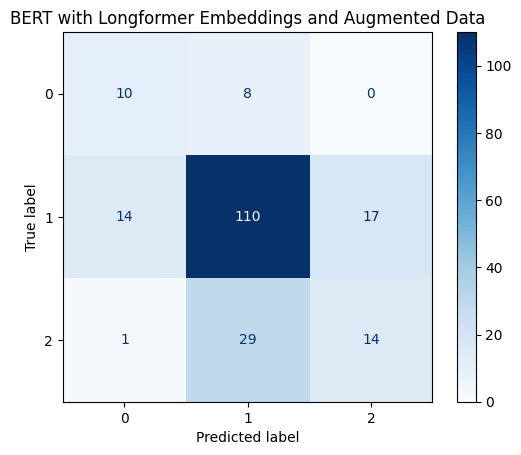

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from transformers import LongformerForSequenceClassification, Trainer

#Run the best BERT-longformer model

def compute_metrics(pred):
    labels = pred.label_ids
    preds = np.argmax(pred.predictions, axis=1)

    precision, recall, f1, _ = precision_recall_fscore_support(
        labels, preds, average='macro', zero_division=0
    )

    acc = accuracy_score(labels, preds)

    # Return metrics as a dictionary
    return {
        'accuracy': acc,
        'f1': f1,
        'precision': precision,
        'recall': recall
    }

best_model = LongformerForSequenceClassification.from_pretrained('/content/drive/MyDrive/MDS project/best_model')

trainer = Trainer(
    model=best_model,
    compute_metrics=compute_metrics

predictions = trainer.predict(text_encoded["test"])

predicted_labels = np.argmax(predictions.predictions, axis=1)

true_labels = text_encoded['test']['label']

cm = confusion_matrix(true_labels, predicted_labels)

disp = ConfusionMatrixDisplay(confusion_matrix=cm)

disp.plot(cmap=plt.cm.Blues)
plt.title("BERT with Longformer Embeddings and Augmented Data")
plt.show()

In [ ]:
report = classification_report(true_labels, predicted_labels, target_names=['Class 0', 'Class 1', 'Class 2'])

print("Classification Report:")
print(report)

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.40      0.56      0.47        18
     Class 1       0.75      0.78      0.76       141
     Class 2       0.45      0.32      0.37        44

    accuracy                           0.66       203
   macro avg       0.53      0.55      0.53       203
weighted avg       0.65      0.66      0.65       203



In [ ]:
import openai
import pandas as pd

import time
import openai
from tenacity import retry, wait_fixed, stop_after_attempt


@retry(wait=wait_fixed(2), stop=stop_after_attempt(5))
def get_embedding(text, model="text-embedding-ada-002"):
    text = text.replace("\n", " ")
    response = openai.Embedding.create(input=[text], model=model)
    return response['data'][0]['embedding']



In [ ]:
testing_set

,Main panel_x,Unit of assessment number_x,Title,cleaned text,5 Class Labels,Summary impact type,9 Class Labels,Variance,sentence tokenized,word tokenized,string,3 Class Labels,gpt_embedding
289,A,2.0,Development and implementation of UK tobacco c...,Smoking is the largest avoidable cause of deat...,4,Health,8,0.000000,"[['smoking', 'large', 'avoidable', 'cause', 'd...","['smoking', 'large', 'avoidable', 'cause', 'de...",smoking large avoidable cause death disability...,2,"[0.054960548877716064, 0.005253832787275314, -..."
1036,A,2.0,Radical reorganisation of trauma services redu...,"In the UK, prior to 2012, major trauma patient...",3,Health,7,0.801551,"[['prior', 'major', 'trauma', 'patient', 'inva...","['prior', 'major', 'trauma', 'patient', 'invar...",prior major trauma patient invariably take nea...,1,"[0.03313501179218292, 0.025889569893479347, -0..."
535,A,4.0,Imaging-based diagnostics for patient selectio...,The benefit of thrombolytic therapy for AIS is...,4,Health,7,0.250000,"[['benefit', 'thrombolytic', 'therapy', 'well'...","['benefit', 'thrombolytic', 'therapy', 'well',...",benefit thrombolytic therapy well established ...,1,"[0.013433797284960747, 0.03742389753460884, -0..."
346,A,3.0,eLearning for safer prescribing practice,We have developed and nationally disseminated ...,3,Societal,7,0.234375,"[['develop', 'nationally', 'disseminate', 'ele...","['develop', 'nationally', 'disseminate', 'elec...",develop nationally disseminate electronic educ...,1,"[-0.0007114423206076026, 0.027826989069581032,..."
1075,A,6.0,Reducing Food Waste by Controlling Ethylene,UN Sustainable Development Goal 12.3 aims to r...,4,Technological,8,0.187500,"[['sustainable', 'development', 'goal'], ['aim...","['sustainable', 'development', 'goal', 'aim', ...",sustainable development goal aim reduce food l...,2,"[-0.015000398270785809, 0.04113832488656044, -..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
318,A,4.0,Do Something Different: achieving positive beh...,The research-based Do Something Different beha...,4,Societal,8,0.000000,"[['researchbased', 'something', 'different', '...","['researchbased', 'something', 'different', 'b...",researchbased something different behavioural ...,2,"[0.003964405041188002, 0.026906108483672142, -..."
1042,A,2.0,Raising the international quality of osteoarth...,We extended understanding of osteoarthritis an...,3,Health,7,0.222111,"[['extend', 'understanding', 'osteoarthritis',...","['extend', 'understanding', 'osteoarthritis', ...",extend understanding osteoarthritis influence ...,1,"[0.01031201146543026, 0.020187312737107277, -0..."
83,A,5.0,Antimicrobial materials: better outcomes for o...,Increasing the range of antibiotics used in PM...,2,Health,5,0.250000,"[['increase', 'range', 'antibiotic', 'use', 'p...","['increase', 'range', 'antibiotic', 'use', 'pm...",increase range antibiotic use pmma bone cement...,0,"[-0.0011697604786604643, 0.031477190554142, -0..."
129,A,3.0,Bridges: advancing the spread of self-manageme...,Development of the Bridges self-management pro...,3,Health,6,0.454204,"[['development', 'bridge', 'selfmanagement', '...","['development', 'bridge', 'selfmanagement', 'p...",development bridge selfmanagement programme be...,1,"[0.012867392040789127, 0.04787344112992287, -0..."


In [ ]:
import sys
sys.modules['openai'] = None

from bertopic import BERTopic

topic_model = BERTopic.load("/content/drive/MyDrive/MDS project/openai topic model")

topics = topic_model.get_topics()



In [ ]:
from datasets import Dataset

def tokenization(batched_text):
    return tokenizer(batched_text['cleaned text'], padding = 'max_length', truncation=True, max_length = 4096)

testing_dataset_2 = Dataset.from_pandas(testing_set)

testing_dataset_2 = testing_dataset_2.map(tokenization, batched = False)

predictions = trainer.predict(testing_dataset_2)

predicted_labels = np.argmax(predictions.predictions, axis=1)

predicted_labels


In [ ]:
testing_set["predicted labels"] = predicted_labels

In [ ]:
testing_set[]

,Main panel_x,Unit of assessment number_x,Title,cleaned text,5 Class Labels,Summary impact type,9 Class Labels,Variance,sentence tokenized,word tokenized,string,3 Class Labels,gpt_embedding,predicted labels
289,A,2.0,Development and implementation of UK tobacco c...,Smoking is the largest avoidable cause of deat...,4,Health,8,0.000000,"[['smoking', 'large', 'avoidable', 'cause', 'd...","['smoking', 'large', 'avoidable', 'cause', 'de...",smoking large avoidable cause death disability...,2,"[0.054960548877716064, 0.005253832787275314, -...",1
1036,A,2.0,Radical reorganisation of trauma services redu...,"In the UK, prior to 2012, major trauma patient...",3,Health,7,0.801551,"[['prior', 'major', 'trauma', 'patient', 'inva...","['prior', 'major', 'trauma', 'patient', 'invar...",prior major trauma patient invariably take nea...,1,"[0.03313501179218292, 0.025889569893479347, -0...",1
535,A,4.0,Imaging-based diagnostics for patient selectio...,The benefit of thrombolytic therapy for AIS is...,4,Health,7,0.250000,"[['benefit', 'thrombolytic', 'therapy', 'well'...","['benefit', 'thrombolytic', 'therapy', 'well',...",benefit thrombolytic therapy well established ...,1,"[0.013433797284960747, 0.03742389753460884, -0...",2
346,A,3.0,eLearning for safer prescribing practice,We have developed and nationally disseminated ...,3,Societal,7,0.234375,"[['develop', 'nationally', 'disseminate', 'ele...","['develop', 'nationally', 'disseminate', 'elec...",develop nationally disseminate electronic educ...,1,"[-0.0007114423206076026, 0.027826989069581032,...",1
1075,A,6.0,Reducing Food Waste by Controlling Ethylene,UN Sustainable Development Goal 12.3 aims to r...,4,Technological,8,0.187500,"[['sustainable', 'development', 'goal'], ['aim...","['sustainable', 'development', 'goal', 'aim', ...",sustainable development goal aim reduce food l...,2,"[-0.015000398270785809, 0.04113832488656044, -...",1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
318,A,4.0,Do Something Different: achieving positive beh...,The research-based Do Something Different beha...,4,Societal,8,0.000000,"[['researchbased', 'something', 'different', '...","['researchbased', 'something', 'different', 'b...",researchbased something different behavioural ...,2,"[0.003964405041188002, 0.026906108483672142, -...",1
1042,A,2.0,Raising the international quality of osteoarth...,We extended understanding of osteoarthritis an...,3,Health,7,0.222111,"[['extend', 'understanding', 'osteoarthritis',...","['extend', 'understanding', 'osteoarthritis', ...",extend understanding osteoarthritis influence ...,1,"[0.01031201146543026, 0.020187312737107277, -0...",2
83,A,5.0,Antimicrobial materials: better outcomes for o...,Increasing the range of antibiotics used in PM...,2,Health,5,0.250000,"[['increase', 'range', 'antibiotic', 'use', 'p...","['increase', 'range', 'antibiotic', 'use', 'pm...",increase range antibiotic use pmma bone cement...,0,"[-0.0011697604786604643, 0.031477190554142, -0...",1
129,A,3.0,Bridges: advancing the spread of self-manageme...,Development of the Bridges self-management pro...,3,Health,6,0.454204,"[['development', 'bridge', 'selfmanagement', '...","['development', 'bridge', 'selfmanagement', 'p...",development bridge selfmanagement programme be...,1,"[0.012867392040789127, 0.04787344112992287, -0...",0


In [ ]:
testing_set

,Main panel_x,Unit of assessment number_x,Title,cleaned text,5 Class Labels,Summary impact type,9 Class Labels,Variance,sentence tokenized,word tokenized,string,3 Class Labels,gpt_embedding
289,A,2.0,Development and implementation of UK tobacco c...,Smoking is the largest avoidable cause of deat...,4,Health,8,0.000000,"[['smoking', 'large', 'avoidable', 'cause', 'd...","['smoking', 'large', 'avoidable', 'cause', 'de...",smoking large avoidable cause death disability...,2,"[0.054960548877716064, 0.005253832787275314, -..."
1036,A,2.0,Radical reorganisation of trauma services redu...,"In the UK, prior to 2012, major trauma patient...",3,Health,7,0.801551,"[['prior', 'major', 'trauma', 'patient', 'inva...","['prior', 'major', 'trauma', 'patient', 'invar...",prior major trauma patient invariably take nea...,1,"[0.03313501179218292, 0.025889569893479347, -0..."
535,A,4.0,Imaging-based diagnostics for patient selectio...,The benefit of thrombolytic therapy for AIS is...,4,Health,7,0.250000,"[['benefit', 'thrombolytic', 'therapy', 'well'...","['benefit', 'thrombolytic', 'therapy', 'well',...",benefit thrombolytic therapy well established ...,1,"[0.013433797284960747, 0.03742389753460884, -0..."
346,A,3.0,eLearning for safer prescribing practice,We have developed and nationally disseminated ...,3,Societal,7,0.234375,"[['develop', 'nationally', 'disseminate', 'ele...","['develop', 'nationally', 'disseminate', 'elec...",develop nationally disseminate electronic educ...,1,"[-0.0007114423206076026, 0.027826989069581032,..."
1075,A,6.0,Reducing Food Waste by Controlling Ethylene,UN Sustainable Development Goal 12.3 aims to r...,4,Technological,8,0.187500,"[['sustainable', 'development', 'goal'], ['aim...","['sustainable', 'development', 'goal', 'aim', ...",sustainable development goal aim reduce food l...,2,"[-0.015000398270785809, 0.04113832488656044, -..."
782,A,4.0,Influencing policy and legislation on diverse ...,Findings from the Centre for Family Research a...,4,Societal,7,0.444111,"[['finding', 'centre', 'family', 'research', '...","['finding', 'centre', 'family', 'research', 'u...",finding centre family research university camb...,1,"[0.012299368157982826, -0.019429678097367287, ..."
303,A,1.0,Development of novel therapies for inborn erro...,"Without treatment, infants with the most sever...",4,Health,8,0.071071,"[['without', 'treatment', 'infant', 'severe', ...","['without', 'treatment', 'infant', 'severe', '...",without treatment infant severe form pid scidx...,2,"[-0.005332517437636852, 0.0542168989777565, -0..."
754,A,3.0,Improving treatment and quality of life for pa...,"Prostate cancer affects 1 in 9 men in the UK, ...",3,Health,7,0.358864,"[['prostate', 'cancer', 'affect', 'men', 'appr...","['prostate', 'cancer', 'affect', 'men', 'appro...",prostate cancer affect men approximately die m...,1,"[0.0042496779933571815, 0.021784130483865738, ..."
536,A,3.0,Impact in the marketplace: translating researc...,Our underpinning research has directly support...,3,Technological,6,0.200000,"[['underpinning', 'research', 'directly', 'sup...","['underpinning', 'research', 'directly', 'supp...",underpinning research directly support interna...,1,"[0.008431951515376568, 0.004191296640783548, -..."
76,A,1.0,Agile drug development and point of care testi...,Research at the University of Southampton over...,4,Technological,7,0.240000,"[['research', 'university', 'southampton', 'pa...","['research', 'university', 'southampton', 'pas...",research university southampton past year lead...,1,"[-0.0070808823220431805, 0.0283857099711895, -..."


In [ ]:
#embeddings = np.array(testing_set["gpt_embedding"].tolist())
#texts = testing_set["cleaned text"].tolist()

# Transform the texts using the precomputed embeddings
#topics, probabilities = topic_model.transform(texts, embeddings=embeddings)

# Output the topics
#print("Topics:", topics)

In [ ]:
#import numpy as np
#from collections import Counter

#non_outlier_topics = [topic for topic in topics if topic != -1]
#most_frequent_topic = Counter(non_outlier_topics).most_common(1)[0][0]

#corrected_topics = [topic if topic != -1 else most_frequent_topic for topic in topics]

#testing_set["assigned_topic"] = corrected_topics

#print(testing_set[["cleaned text", "assigned_topic"]])
# Print out the topic information summary
#print(topic_info)

In [ ]:
topic_class_df = testing_set[["Assigned_Topic", "predicted labels"]]


In [ ]:
topic_distribution = topic_class_df.groupby("predicted labels")["Assigned_Topic"].value_counts().unstack().fillna(0)


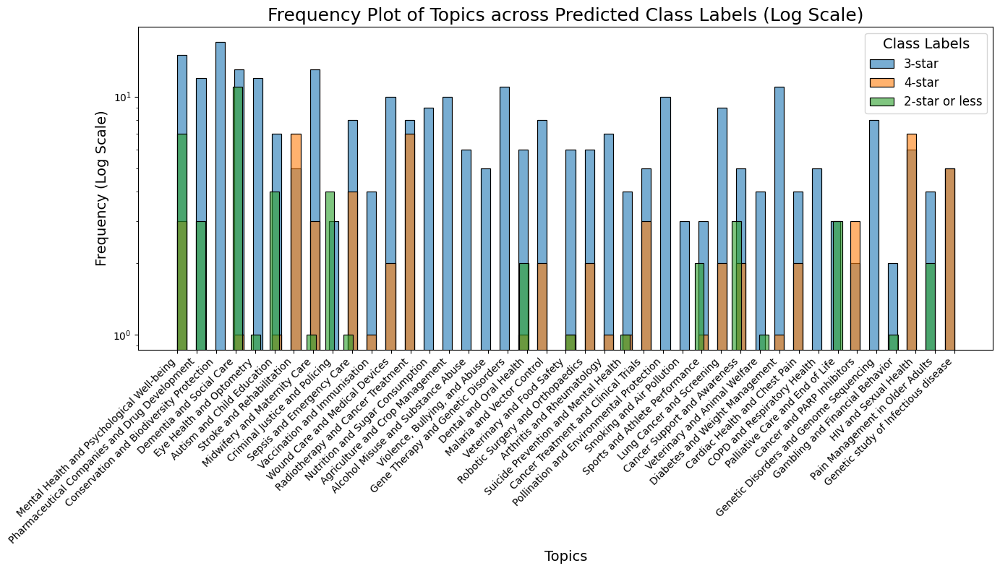

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Assuming 'assigned_topic' and 'predicted labels' are already in your testing_set
# Create a DataFrame with topics and predicted class labels
topic_class_df = testing_set[["Assigned_Topic", "predicted labels"]]

# Your list of topic names
topic_names = [
    "Mental Health and Psychological Well-being", "Pharmaceutical Companies and Drug Development",
    "Conservation and Biodiversity Protection", "Dementia and Social Care", "Eye Health and Optometry",
    "Autism and Child Education", "Stroke and Rehabilitation", "Midwifery and Maternity Care",
    "Criminal Justice and Policing", "Sepsis and Emergency Care", "Vaccination and Immunisation",
    "Wound Care and Medical Devices", "Radiotherapy and Cancer Treatment", "Nutrition and Sugar Consumption",
    "Agriculture and Crop Management", "Alcohol Misuse and Substance Abuse", "Violence, Bullying, and Abuse",
    "Gene Therapy and Genetic Disorders", "Dental and Oral Health", "Malaria and Vector Control",
    "Veterinary and Food Safety", "Robotic Surgery and Orthopaedics", "Arthritis and Rheumatology",
    "Suicide Prevention and Mental Health", "Cancer Treatment and Clinical Trials",
    "Pollination and Environmental Protection", "Smoking and Air Pollution", "Sports and Athlete Performance",
    "Lung Cancer and Screening", "Cancer Support and Awareness", "Veterinary and Animal Welfare",
    "Diabetes and Weight Management", "Cardiac Health and Chest Pain", "COPD and Respiratory Health",
    "Palliative Care and End of Life", "Cancer and PARP Inhibitors", "Genetic Disorders and Genome Sequencing",
    "Gambling and Financial Behavior", "HIV and Sexual Health", "Pain Management in Older Adults",
    "Genetic study of Infectious disease"
]

# Mapping class labels to star ratings
class_label_mapping = {
    0: '2-star or less',
    1: '3-star',
    2: '4-star'
}

# Use the 'tab10' palette for distinct colors
palette = sns.color_palette('tab10')

# Plot topic frequencies for each class label using histograms
plt.figure(figsize=(14, 8))

# Increase the number of bins to make the bars finer
num_bins = len(topic_names) * 2  # Finer bars by doubling unique topics

# Get unique class labels
class_labels = topic_class_df["predicted labels"].unique()

# Plot a frequency plot for each class label in one plot
for i, label in enumerate(class_labels):
    # Filter the DataFrame for the current class label
    filtered_df = topic_class_df[topic_class_df["predicted labels"] == label]

    # Plot a histogram with finer bars (more bins) for the assigned topics and assign a color from the palette
    sns.histplot(filtered_df["Assigned_Topic"], label=class_label_mapping[label], kde=False, bins=num_bins,
                 alpha=0.6, color=palette[i % len(palette)])  # Ensuring we loop through palette if needed

# Set plot labels and title
plt.title('Frequency Plot of Topics across Predicted Class Labels (Log Scale)', fontsize=18)
plt.xlabel('Topics', fontsize=14)
plt.ylabel('Frequency (Log Scale)', fontsize=14)

# Set custom x-ticks with the topic names and rotate them 45 degrees clockwise for better readability
plt.xticks(ticks=range(len(topic_names)), labels=topic_names, rotation=45, ha='right', fontsize=10)

# Apply a logarithmic scale to the y-axis
plt.yscale('log')

# Display the legend with custom labels
plt.legend(title="Class Labels", fontsize=12, title_fontsize=14)

# Show the plot
plt.tight_layout()
plt.show()

In [ ]:
import optuna
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import f1_score, classification_report

training_set, testing_set = train_test_split(
    df, test_size=0.3, random_state=42  # 50% training, 50% temporary
)

X_train = training_set["string"]
y_train = training_set["3 Class Labels"]

X_test = testing_set["string"]
y_test = testing_set["3 Class Labels"]

vectorizer = CountVectorizer()

X_train_bow = vectorizer.fit_transform(X_train)
X_test_bow = vectorizer.transform(X_test)

def objective(trial):
    alpha = trial.suggest_loguniform('alpha', 1e-3, 10)

    nb_model = MultinomialNB(alpha=alpha)

    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

    y_pred = cross_val_predict(nb_model, X_train_bow, y_train, cv=skf)
    macro_f1 = f1_score(y_train, y_pred, average='macro')

    return macro_f1


study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10)

best_params = study.best_params
print(f"Best hyperparameters: {best_params}")

nb_model = MultinomialNB(alpha=best_params['alpha'])
nb_model.fit(X_train_bow, y_train)

y_pred = nb_model.predict(X_test_bow)

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy * 100:.2f}%")
print("Classification Report:\n", report)

[I 2024-09-14 18:14:22,462] A new study created in memory with name: no-name-b41c20f9-a55c-466f-89b8-883ddacd562f
<ipython-input-21-85b587a4718e>:26: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  alpha = trial.suggest_loguniform('alpha', 1e-3, 10)
[I 2024-09-14 18:14:22,506] Trial 0 finished with value: 0.36100533721913797 and parameters: {'alpha': 2.135077196010628}. Best is trial 0 with value: 0.36100533721913797.
<ipython-input-21-85b587a4718e>:26: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  alpha = trial.suggest_loguniform('alpha', 1e-3, 10)
[I 2024-09-14 18:14:22,541] Trial 1 finished with value: 0.5004405885170377 and parameters: {'alpha': 0.047701424660312956}.

Best hyperparameters: {'alpha': 0.0112415244177348}
Accuracy: 64.44%
Classification Report:
               precision    recall  f1-score   support

           0       0.59      0.30      0.40        43
           1       0.70      0.81      0.75       264
           2       0.44      0.35      0.39        98

    accuracy                           0.64       405
   macro avg       0.58      0.49      0.51       405
weighted avg       0.63      0.64      0.63       405



In [ ]:
test_dataset

training_set = training_set.reset_index(drop=True)
testing_set = testing_set.reset_index(drop=True)



,136
Main panel_x,A
Unit of assessment number_x,3.0
Title,Influencing Change in UNICEF?s Baby Friendly H...
cleaned text,"Following an update of the evidence, UNICEF ha..."
5 Class Labels,3
Summary impact type,Health
9 Class Labels,6
Variance,0.572
sentence tokenized,"[['follow', 'update', 'evidence', 'unicef', 'e..."
word tokenized,"['follow', 'update', 'evidence', 'unicef', 'ex..."


In [ ]:
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.naive_bayes import MultinomialNB
from lime.lime_text import LimeTextExplainer
from sklearn.pipeline import make_pipeline

training_set = training_set.reset_index(drop=True)
testing_set = testing_set.reset_index(drop=True)

pipeline = make_pipeline(vectorizer, nb_model)

explainer = LimeTextExplainer(class_names=['2-star or Less', '3-star', '4-star'])


#The index of data points from testing set that have 0 variance
indices = [21, 32, 35, 90, 106, 120, 136, 138, 140, 141]

idx = 136
text = text_encoded["test"]["text"][idx]
text = preprocess_text(text)

def flatten(sents_tokenized):
    return [word for sentence in sents_tokenized for word in sentence]

def tokens_to_string(tokens):
    return ' '.join(tokens)


text = flatten(text)

text = tokens_to_string(text)

print(text)

print(text_encoded["test"]["label"][idx])

# Get the explanation for the specific instance across all three labels
explanation = explainer.explain_instance(text,
                                         pipeline.predict_proba,
                                         num_features=20,
                                         labels=[0, 1, 2])

# Use LIME's built-in visualization with matplotlib
explanation.show_in_notebook(text=True)
plt.show()

In [ ]:
from datasets import Dataset


short_data = [v for v in text_encoded["test"]["text"]]

data_dict = {"text": short_data}

dataset = Dataset.from_dict(data_dict)

print(dataset)


Dataset({
    features: ['text'],
    num_rows: 203
})


In [ ]:
import shap
from transformers import pipeline

classifier = pipeline('text-classification', return_all_scores=True, model=best_model,tokenizer=tokenizer, device=0 )

classifier


In [ ]:
explainer = shap.Explainer(classifier)



In [ ]:
indices = [21, 32, 35, 90, 106, 120, 136, 138, 140, 141]
subset = dataset.select(indices)

subset


Dataset({
    features: ['text'],
    num_rows: 10
})

In [ ]:
shap_values = explainer(subset["text"])

shap_values

Input ids are automatically padded to be a multiple of `config.attention_window`: 512


  0%|          | 0/498 [00:00<?, ?it/s]

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
PartitionExplainer explainer:  10%|█         | 1/10 [00:00<?, ?it/s]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|███       | 3/10 [03:01<04:38, 39.74s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|████      | 4/10 [04:00<04:46, 47.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|█████     | 5/10 [05:19<04:57, 59.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|██████    | 6/10 [06:16<03:54, 58.59s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|███████   | 7/10 [07:15<02:56, 58.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|████████  | 8/10 [08:14<01:57, 58.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|█████████ | 9/10 [09:34<01:05, 65.67s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 100%|██████████| 10/10 [10:33<00:00, 63.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 11it [11:32, 69.28s/it]


.values =
array([array([[-0.00133481,  0.00198677, -0.00065196],
              [-0.00133481,  0.00198677, -0.00065196],
              [-0.00133481,  0.00198677, -0.00065196],
              ...,
              [-0.0010027 ,  0.00070028,  0.00030243],
              [-0.0010027 ,  0.00070028,  0.00030243],
              [-0.0010027 ,  0.00070028,  0.00030243]]),
       array([[-3.40854157e-05,  8.10832904e-05, -4.69978979e-05],
              [-3.40854157e-05,  8.10832904e-05, -4.69978979e-05],
              [-3.40854157e-05,  8.10832904e-05, -4.69978979e-05],
              ...,
              [ 6.30497795e-05,  3.01441054e-04, -3.64490806e-04],
              [ 6.30497795e-05,  3.01441054e-04, -3.64490806e-04],
              [ 6.30497795e-05,  3.01441054e-04, -3.64490806e-04]]),
       array([[ 2.85453638e-04, -1.98557620e-04, -8.68956543e-05],
              [ 2.85453638e-04, -1.98557620e-04, -8.68956543e-05],
              [ 2.85453638e-04, -1.98557620e-04, -8.68956543e-05],
              .

In [ ]:
indices = [21, 32, 35, 90, 106, 120, 136, 138, 140, 141]

text_encoded["test"]["label"][indices]

tensor([2, 2, 0, 1, 2, 1, 0, 1, 1, 2])

In [ ]:
text_encoded["train"]["label"]

tensor([2, 1, 2,  ..., 2, 1, 1])

In [ ]:

custom_labels = ["Unclassified, 1-star and 2-star", "3-star", "4-star"]
shap_values.output_names = custom_labels

shap.plots.text(shap_values[6])

In [ ]:
text_encoded["test"]["label"][30]

2

In [ ]:
testing_set

,Main panel_x,Unit of assessment number_x,Title,cleaned text,5 Class Labels,Summary impact type,9 Class Labels,Variance,sentence tokenized,word tokenized,string,3 Class Labels,gpt_embedding
0,A,2.0,Development and implementation of UK tobacco c...,Smoking is the largest avoidable cause of deat...,4,Health,8,0.000000,"[['smoking', 'large', 'avoidable', 'cause', 'd...","['smoking', 'large', 'avoidable', 'cause', 'de...",smoking large avoidable cause death disability...,2,"[0.054960548877716064, 0.005253832787275314, -..."
1,A,2.0,Radical reorganisation of trauma services redu...,"In the UK, prior to 2012, major trauma patient...",3,Health,7,0.801551,"[['prior', 'major', 'trauma', 'patient', 'inva...","['prior', 'major', 'trauma', 'patient', 'invar...",prior major trauma patient invariably take nea...,1,"[0.03313501179218292, 0.025889569893479347, -0..."
2,A,4.0,Imaging-based diagnostics for patient selectio...,The benefit of thrombolytic therapy for AIS is...,4,Health,7,0.250000,"[['benefit', 'thrombolytic', 'therapy', 'well'...","['benefit', 'thrombolytic', 'therapy', 'well',...",benefit thrombolytic therapy well established ...,1,"[0.013433797284960747, 0.03742389753460884, -0..."
3,A,3.0,eLearning for safer prescribing practice,We have developed and nationally disseminated ...,3,Societal,7,0.234375,"[['develop', 'nationally', 'disseminate', 'ele...","['develop', 'nationally', 'disseminate', 'elec...",develop nationally disseminate electronic educ...,1,"[-0.0007114423206076026, 0.027826989069581032,..."
4,A,6.0,Reducing Food Waste by Controlling Ethylene,UN Sustainable Development Goal 12.3 aims to r...,4,Technological,8,0.187500,"[['sustainable', 'development', 'goal'], ['aim...","['sustainable', 'development', 'goal', 'aim', ...",sustainable development goal aim reduce food l...,2,"[-0.015000398270785809, 0.04113832488656044, -..."
5,A,4.0,Influencing policy and legislation on diverse ...,Findings from the Centre for Family Research a...,4,Societal,7,0.444111,"[['finding', 'centre', 'family', 'research', '...","['finding', 'centre', 'family', 'research', 'u...",finding centre family research university camb...,1,"[0.012299368157982826, -0.019429678097367287, ..."
6,A,1.0,Development of novel therapies for inborn erro...,"Without treatment, infants with the most sever...",4,Health,8,0.071071,"[['without', 'treatment', 'infant', 'severe', ...","['without', 'treatment', 'infant', 'severe', '...",without treatment infant severe form pid scidx...,2,"[-0.005332517437636852, 0.0542168989777565, -0..."
7,A,3.0,Improving treatment and quality of life for pa...,"Prostate cancer affects 1 in 9 men in the UK, ...",3,Health,7,0.358864,"[['prostate', 'cancer', 'affect', 'men', 'appr...","['prostate', 'cancer', 'affect', 'men', 'appro...",prostate cancer affect men approximately die m...,1,"[0.0042496779933571815, 0.021784130483865738, ..."
8,A,3.0,Impact in the marketplace: translating researc...,Our underpinning research has directly support...,3,Technological,6,0.200000,"[['underpinning', 'research', 'directly', 'sup...","['underpinning', 'research', 'directly', 'supp...",underpinning research directly support interna...,1,"[0.008431951515376568, 0.004191296640783548, -..."
9,A,1.0,Agile drug development and point of care testi...,Research at the University of Southampton over...,4,Technological,7,0.240000,"[['research', 'university', 'southampton', 'pa...","['research', 'university', 'southampton', 'pas...",research university southampton past year lead...,1,"[-0.0070808823220431805, 0.0283857099711895, -..."


In [ ]:
augmented_df

,Main panel_x,Unit of assessment number_x,Title,cleaned text,5 Class Labels,Summary impact type,9 Class Labels,Variance,sentence tokenized,word tokenized,string,3 Class Labels,gpt_embedding,Assigned_Topic
1216,A,5.0,Delivery of new and repurposed drugs for visce...,"the discovery by fairlamb, collins and wyllie ...",4,Technological,8,0.139111,"[['discovery', 'fairlamb', 'read', 'wyllie', '...","['discovery', 'fairlamb', 'read', 'wyllie', 'o...",discovery fairlamb read wyllie oral fexinidazo...,2,"[-0.0047755166888237, 0.046099208295345306, -0...",19
420,A,5.0,Life-changing treatments and clinical tools fo...,"NP-C is a rare disease (1 in 100,000 live birt...",4,Health,7,0.206736,"[['npc', 'rare', 'disease', 'live', 'births', ...","['npc', 'rare', 'disease', 'live', 'births', '...",npc rare disease live births highly variable u...,1,"[0.002350838854908943, 0.028548315167427063, -...",17
1383,A,4.0,Public engagement as a vital facilitator of po...,four types of impact arose from cardiff ’ s re...,4,Environmental,8,0.172716,"[['four', 'type', 'impact', 'arise', 'cardiffs...","['four', 'type', 'impact', 'arise', 'cardiffs'...",four type impact arise cardiffs research inclu...,2,"[-0.019994547590613365, 0.04001941159367561, -...",2
700,A,2.0,Implementing PINCER to reduce medication error...,We have developed and tested a pharmacist-led ...,4,Health,8,0.000000,"[['develop', 'test', 'pharmacistled', 'itbased...","['develop', 'test', 'pharmacistled', 'itbased'...",develop test pharmacistled itbased interventio...,2,"[-0.004534679464995861, 0.03787204995751381, -...",9
599,A,4.0,Influencing UK policy to reduce the harmful im...,Changing UK gambling laws for Fixed Odds Betti...,4,Societal,7,0.240000,"[['change', 'gamble', 'law', 'fixed', 'odds', ...","['change', 'gamble', 'law', 'fixed', 'odds', '...",change gamble law fixed odds bet terminal fobt...,1,"[0.04228265583515167, 0.014309595339000225, -0...",37
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1095,A,3.0,Improving healthcare systems to tackle antimic...,The resistance of bacteria to antibiotics thre...,3,Health,6,0.472444,"[['resistance', 'bacteria', 'antibiotic', 'thr...","['resistance', 'bacteria', 'antibiotic', 'thre...",resistance bacteria antibiotic threaten abilit...,1,"[-0.020858092233538628, 0.052630841732025146, ...",20
1130,A,3.0,Impact of research on ?Super-Recognisers? on t...,Davis' research has had wide-ranging impact en...,3,Technological,5,0.222111,"[['davis', 'research', 'wideranging', 'impact'...","['davis', 'research', 'wideranging', 'impact',...",davis research wideranging impact enhance deli...,0,"[0.06172199174761772, -0.009172838181257248, -...",8
1294,A,4.0,Improving mental health and wellbeing through ...,chronic insomnia affects people through lack o...,4,Health,8,0.090000,"[['chronic', 'insomnia', 'affect', 'people', '...","['chronic', 'insomnia', 'affect', 'people', 'l...",chronic insomnia affect people lack energy poo...,2,"[0.012708737514913082, 0.008121171966195107, -...",0
860,A,5.0,Restoring European Native Oysters through evid...,"Details of the impact The Blackwater, Crouch, ...",3,Environmental,6,0.437500,"[['detail', 'impact', 'blackwater', 'crouch', ...","['detail', 'impact', 'blackwater', 'crouch', '...",detail impact blackwater crouch roach colne es...,1,"[0.0008858794462867081, 0.003286327002570033, ...",2


In [ ]:
X_train = np.vstack(augmented_df["gpt_embedding"].values)
y_train = augmented_df["3 Class Labels"].values

X_test = np.vstack(testing_set["gpt_embedding"].values)
y_test = testing_set["3 Class Labels"].values

X_train

array([[-0.00477552,  0.04609921, -0.00840106, ..., -0.01267059,
        -0.01977114, -0.02174491],
       [ 0.00235084,  0.02854832, -0.01819786, ...,  0.0006543 ,
        -0.00318378, -0.00331485],
       [-0.01999455,  0.04001941, -0.02486054, ..., -0.027862  ,
         0.02114662, -0.00638946],
       ...,
       [ 0.01270874,  0.00812117, -0.02910852, ..., -0.02300343,
        -0.00844042, -0.00426394],
       [ 0.00088588,  0.00328633, -0.01093265, ..., -0.01923624,
        -0.00909557,  0.00694415],
       [ 0.01968912,  0.02073982, -0.00928115, ..., -0.01920184,
         0.00841318,  0.00039235]])

[I 2024-09-12 16:12:48,411] A new study created in memory with name: no-name-c3349a39-2441-4afa-91fd-9fd339f3f110
[I 2024-09-12 16:13:07,121] Trial 0 finished with value: 0.8838549937048727 and parameters: {'eta': 0.12494291388866716, 'n_estimators': 488, 'learning_rate': 0.04820304967689455, 'max_depth': 9, 'min_child_weight': 2, 'subsample': 0.6674073572242665, 'colsample_bytree': 0.5537486741324802, 'gamma': 1.0219500210295491, 'alpha': 0.07753217162140016, 'lambda': 0.3394547840133551}. Best is trial 0 with value: 0.8838549937048727.
[I 2024-09-12 16:13:12,712] Trial 1 finished with value: 0.6646212699017202 and parameters: {'eta': 0.014727625522427096, 'n_estimators': 307, 'learning_rate': 0.07217753233620922, 'max_depth': 6, 'min_child_weight': 181, 'subsample': 0.8897084446150476, 'colsample_bytree': 0.6133963760770582, 'gamma': 4.486383741790906, 'alpha': 0.5313127068486219, 'lambda': 0.2714391855470399}. Best is trial 0 with value: 0.8838549937048727.
[I 2024-09-12 16:13:33,77

Test Macro F1 Score: 0.42226793248945144


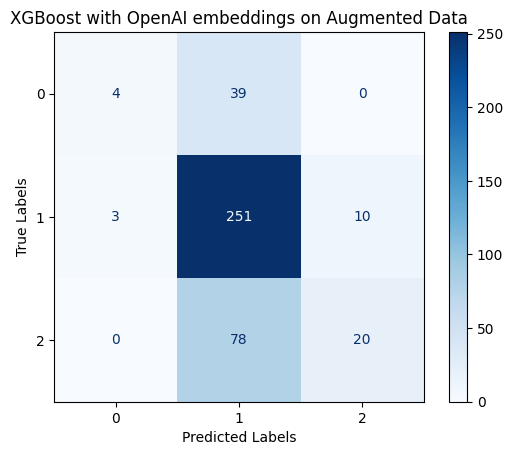

In [ ]:
from sklearn.model_selection import StratifiedKFold
from xgboost import XGBClassifier, DMatrix, train as xgb_train
import optuna
from optuna.integration import XGBoostPruningCallback
from sklearn.metrics import f1_score, confusion_matrix, ConfusionMatrixDisplay
import numpy as np
import joblib
import matplotlib.pyplot as plt
from sklearn.utils.class_weight import compute_class_weight
from sklearn.model_selection import cross_val_score, StratifiedKFold

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)


def objective(trial):
    param = {
        'verbosity': 0,
        'objective': 'multi:softmax',
        'num_class': 3,
        'booster': 'gbtree',
        'eta': trial.suggest_float('eta', 0.01, 0.2, log=True),
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 1.0, log=True),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 250),
        'subsample': trial.suggest_float('subsample', 0.5, 1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1),
        'gamma': trial.suggest_float('gamma', 0.0, 5),
        'alpha': trial.suggest_float('alpha', 0.01, 1.0, log=True),
        'lambda': trial.suggest_float('lambda', 0.01, 1.0, log=True),
        'eval_metric': 'mlogloss',
        'tree_method': 'gpu_hist',
        'gpu_id': 0
    }

    model = XGBClassifier(**param)

    scores = cross_val_score(model, X_train, y_train, cv=cv, scoring='f1_macro')

    return scores.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10)

best_params = study.best_trial.params

final_model = XGBClassifier(**best_params, tree_method='gpu_hist', gpu_id=0, use_label_encoder=False)

final_model.fit(X_train, y_train)

joblib.dump(final_model, 'best_model.pkl')

y_test_pred = final_model.predict(X_test)

test_macro_f1 = f1_score(y_test, y_test_pred, average='macro')
print("Test Macro F1 Score: {}".format(test_macro_f1))

cm = confusion_matrix(y_test, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=np.unique(y_test))
disp.plot(cmap=plt.cm.Blues)

plt.title('XGBoost with OpenAI embeddings on Augmented Data')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')


plt.show()

In [ ]:
pip install openai==0.28

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.5/76.5 kB 8.2 MB/s eta 0:00:00


In [ ]:
import openai
import pandas as pd

openai.api_key = ''
def get_embedding(text, model="text-embedding-3-large"):
    text = text.replace("\n", " ")
    response = openai.Embedding.create(input=[text], model=model)
    return response['data'][0]['embedding']


In [ ]:
#from sklearn.base import BaseEstimator, TransformerMixin
#from sklearn.pipeline import Pipeline
#import numpy as np

#class EmbeddingTransformer(BaseEstimator, TransformerMixin):
#    def __init__(self, embedding_model="text-embedding-3-large"):
#        self.embedding_model = embedding_model

#    def fit(self, X, y=None):
#        return self
#
#    def transform(self, X):
#        return np.array([self.get_embedding(text) for text in X])
#
#    def get_embedding(self, text):
#        embedding = get_embedding(text, model=self.embedding_model)
#        return embedding

#pipeline = Pipeline([
#    ('embedding', EmbeddingTransformer(embedding_model="text-embedding-3-large")),
#    ('classifier', final_model)  # final_model should support predict_proba
#])

#texts = ["Your text 1", "Another text example"]
#probabilities = pipeline.predict_proba(texts)
#print(probabilities)

In [ ]:
training_set, testing_set = train_test_split(
    new_df, test_size=0.3, random_state=42  # 50% training, 50% temporary
)


In [ ]:
from transformers import LongformerModel, LongformerTokenizer
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = LongformerModel.from_pretrained('allenai/longformer-base-4096').to(device)
tokenizer = LongformerTokenizer.from_pretrained('allenai/longformer-base-4096')

def get_longformer_embeddings(text):
    inputs = tokenizer(text, return_tensors="pt", max_length=4096, truncation=True, padding=True)
    inputs = {key: value.to(device) for key, value in inputs.items()}

    with torch.no_grad():
        outputs = model(**inputs)

    embeddings = outputs.last_hidden_state.mean(dim=1)

    return embeddings.squeeze().cpu().numpy()



/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [ ]:
from tqdm.notebook import tqdm
import numpy as np

tqdm.pandas()

augmented_df['bert_embeddings'] = augmented_df['cleaned text'].progress_apply(lambda x: get_longformer_embeddings(x))
testing_set['bert_embeddings'] = testing_set['cleaned text'].progress_apply(lambda x: get_longformer_embeddings(x))


  0%|          | 0/1395 [00:00<?, ?it/s]

  0%|          | 0/405 [00:00<?, ?it/s]

In [ ]:
X_train = np.vstack(augmented_df["bert_embeddings"].values)
y_train = augmented_df["3 Class Labels"].values

X_test = np.vstack(testing_set["bert_embeddings"].values)
y_test = testing_set["3 Class Labels"].values

X_train

array([[ 0.05527014,  0.07230853, -0.03545693, ..., -0.13216498,
         0.02227878, -0.03921686],
       [ 0.03163595,  0.11599128, -0.04109016, ..., -0.10287514,
         0.03401282, -0.09175961],
       [ 0.05785831, -0.01585873,  0.07101645, ..., -0.14103039,
         0.04182259, -0.01774611],
       ...,
       [ 0.00661036,  0.02700312,  0.02794365, ..., -0.12469079,
         0.02508792, -0.00676149],
       [ 0.07922155,  0.08826832,  0.08758541, ..., -0.02454169,
         0.05348718, -0.09467671],
       [ 0.06118973,  0.04125423,  0.0193759 , ..., -0.09837901,
         0.10096056, -0.09213252]], dtype=float32)

In [ ]:
import gensim
import numpy as np
from tqdm.notebook import tqdm
tqdm.pandas()
import gensim.downloader as api

# Load the FastText model (make sure to specify the correct path to your model)
fasttext_model = api.load('fasttext-wiki-news-subwords-300')

##glove_model = api.load('glove-wiki-gigaword-300')  # Use a 300-dimensional GloVe model


In [ ]:
from sklearn.utils import shuffle
import nlpaug.augmenter.word as naw
import pandas as pd
import numpy as np
from tqdm import tqdm

def augment_text(df, samples, class_id):
    contextual_aug = naw.ContextualWordEmbsAug(model_path='bert-base-uncased', action='substitute', device='cuda')
    np.random.seed(42)

    df_minority = df[df["3 Class Labels"] == class_id].reset_index(drop=True)

    new_rows = []

    for i in tqdm(np.random.randint(0, len(df_minority), samples)):
        row_copy = df_minority.iloc[i].copy()

        paragraphs = row_copy['cleaned text'].split('\n')

        augmented_paragraphs = []

        for paragraph in paragraphs:
            if paragraph.strip():  # Ensure the paragraph is not empty
                augmented_paragraph = contextual_aug.augment(paragraph)
                augmented_paragraphs.append(augmented_paragraph[0])
            else:
                augmented_paragraphs.append(paragraph)  # Preserve empty lines

        row_copy['cleaned text'] = '\n'.join(augmented_paragraphs)

        new_rows.append(row_copy)

    new_df = pd.DataFrame(new_rows)

    df_augmented = pd.concat([df, new_df]).reset_index(drop=True)

    seed = 42
    df_augmented = shuffle(df_augmented, random_state=seed)

    return df_augmented

augmented_df = augment_text(training_set, 200, 0)
augmented_df = augment_text(augmented_df, 250, 2)

100%|██████████| 250/250 [03:40<00:00,  1.13it/s]


In [ ]:
from tqdm.notebook import tqdm

tqdm.pandas()

def text_to_embedding(tokens, model):
    embeddings = [model[word] for word in tokens if word in model]
    if len(embeddings) == 0:
        return np.zeros(model.vector_size)  # Return a zero vector if no valid words
    return np.mean(embeddings, axis=0)

#augmented_df['embeddings'] = augmented_df['word tokenized'].progress_apply(lambda tokens: text_to_embedding(tokens, fasttext_model))
augmented_df['embeddings'] = augmented_df['word tokenized'].progress_apply(lambda tokens: text_to_embedding(tokens, fasttext_model))

#testing_set['embeddings'] = testing_set['word tokenized'].progress_apply(lambda tokens: text_to_embedding(tokens, fasttext_model))
testing_set['embeddings'] = testing_set['word tokenized'].progress_apply(lambda tokens: text_to_embedding(tokens, fasttext_model))


  0%|          | 0/1395 [00:00<?, ?it/s]

  0%|          | 0/405 [00:00<?, ?it/s]

In [ ]:
augmented_df

,Main panel_x,Unit of assessment number_x,Title,cleaned text,5 Class Labels,Summary impact type,9 Class Labels,Variance,sentence tokenized,word tokenized,string,3 Class Labels,gpt_embedding,bert_embeddings
1216,A,5.0,Delivery of new and repurposed drugs for visce...,"the discovery by fairlamb, collins and wyllie ...",4,Technological,8,0.139111,"[['discovery', 'fairlamb', 'read', 'wyllie', '...","['discovery', 'fairlamb', 'read', 'wyllie', 'o...",discovery fairlamb read wyllie oral fexinidazo...,2,"[-0.0047755166888237, 0.046099208295345306, -0...","[0.055270135, 0.07230853, -0.035456926, 0.0066..."
420,A,5.0,Life-changing treatments and clinical tools fo...,"NP-C is a rare disease (1 in 100,000 live birt...",4,Health,7,0.206736,"[['npc', 'rare', 'disease', 'live', 'births', ...","['npc', 'rare', 'disease', 'live', 'births', '...",npc rare disease live births highly variable u...,1,"[0.002350838854908943, 0.028548315167427063, -...","[0.03163595, 0.11599128, -0.04109016, 0.035135..."
1383,A,4.0,Public engagement as a vital facilitator of po...,four types of impact arose from cardiff ’ s re...,4,Environmental,8,0.172716,"[['four', 'type', 'impact', 'arise', 'cardiffs...","['four', 'type', 'impact', 'arise', 'cardiffs'...",four type impact arise cardiffs research inclu...,2,"[-0.019994547590613365, 0.04001941159367561, -...","[0.057858307, -0.015858727, 0.07101645, -0.002..."
700,A,2.0,Implementing PINCER to reduce medication error...,We have developed and tested a pharmacist-led ...,4,Health,8,0.000000,"[['develop', 'test', 'pharmacistled', 'itbased...","['develop', 'test', 'pharmacistled', 'itbased'...",develop test pharmacistled itbased interventio...,2,"[-0.004534679464995861, 0.03787204995751381, -...","[0.026576618, 0.024640061, -0.03458651, 0.0585..."
599,A,4.0,Influencing UK policy to reduce the harmful im...,Changing UK gambling laws for Fixed Odds Betti...,4,Societal,7,0.240000,"[['change', 'gamble', 'law', 'fixed', 'odds', ...","['change', 'gamble', 'law', 'fixed', 'odds', '...",change gamble law fixed odds bet terminal fobt...,1,"[0.04228265583515167, 0.014309595339000225, -0...","[0.06114954, 0.08227704, 0.02245543, -0.010974..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1095,A,3.0,Improving healthcare systems to tackle antimic...,The resistance of bacteria to antibiotics thre...,3,Health,6,0.472444,"[['resistance', 'bacteria', 'antibiotic', 'thr...","['resistance', 'bacteria', 'antibiotic', 'thre...",resistance bacteria antibiotic threaten abilit...,1,"[-0.020858092233538628, 0.052630841732025146, ...","[0.06512534, 0.051277574, -0.048073735, 0.0136..."
1130,A,3.0,Impact of research on ?Super-Recognisers? on t...,Davis' research has had wide-ranging impact en...,3,Technological,5,0.222111,"[['davis', 'research', 'wideranging', 'impact'...","['davis', 'research', 'wideranging', 'impact',...",davis research wideranging impact enhance deli...,0,"[0.06172199174761772, -0.009172838181257248, -...","[0.00077745965, 0.070501655, 0.016726835, -0.0..."
1294,A,4.0,Improving mental health and wellbeing through ...,chronic insomnia affects people through lack o...,4,Health,8,0.090000,"[['chronic', 'insomnia', 'affect', 'people', '...","['chronic', 'insomnia', 'affect', 'people', 'l...",chronic insomnia affect people lack energy poo...,2,"[0.012708737514913082, 0.008121171966195107, -...","[0.006610358, 0.027003115, 0.027943647, -0.037..."
860,A,5.0,Restoring European Native Oysters through evid...,"Details of the impact The Blackwater, Crouch, ...",3,Environmental,6,0.437500,"[['detail', 'impact', 'blackwater', 'crouch', ...","['detail', 'impact', 'blackwater', 'crouch', '...",detail impact blackwater crouch roach colne es...,1,"[0.0008858794462867081, 0.003286327002570033, ...","[0.07922155, 0.088268325, 0.08758541, 0.041110..."


In [ ]:
pip install optuna-integration[xgboost]

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 362.8/362.8 kB 30.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.9/96.9 kB 11.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.0/233.0 kB 23.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 9.1 MB/s eta 0:00:00


In [ ]:
X_train = np.vstack(augmented_df["gpt_embedding"].values)
y_train = augmented_df["3 Class Labels"].values

X_test = np.vstack(testing_set["gpt_embedding"].values)
y_test = testing_set["3 Class Labels"].values

X_test_scaled = X_test

X_train_scaled = X_train

[I 2024-09-15 00:17:14,088] A new study created in memory with name: no-name-be5d8eee-3a8b-4595-aff6-fc2657ca51f5
[I 2024-09-15 00:17:23,534] Trial 0 finished with value: 0.6776978506502074 and parameters: {'eta': 0.08648740883274926, 'n_estimators': 113, 'learning_rate': 0.01069064069636314, 'max_depth': 6, 'min_child_weight': 56, 'subsample': 0.8795211215764553, 'colsample_bytree': 0.5022408551019855, 'gamma': 4.135206259561642, 'alpha': 0.07943367750127633, 'lambda': 4.255489597519396}. Best is trial 0 with value: 0.6776978506502074.
[I 2024-09-15 00:17:52,175] Trial 1 finished with value: 0.7995579327309608 and parameters: {'eta': 0.18470628930120955, 'n_estimators': 737, 'learning_rate': 0.060016344386160894, 'max_depth': 7, 'min_child_weight': 95, 'subsample': 0.7790741378374346, 'colsample_bytree': 0.684282456292538, 'gamma': 0.1452093909362645, 'alpha': 0.1170067659663019, 'lambda': 0.46722855775237954}. Best is trial 1 with value: 0.7995579327309608.
[I 2024-09-15 00:18:03,737

Test Macro F1 Score: 0.5171458171458171


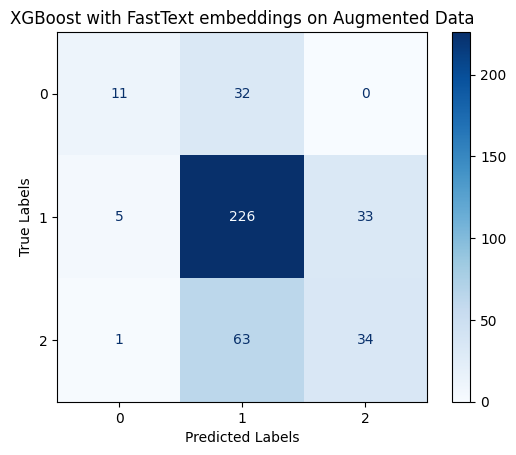

In [ ]:
from sklearn.model_selection import StratifiedKFold
from xgboost import XGBClassifier, DMatrix, train as xgb_train
import optuna
from optuna.integration import XGBoostPruningCallback
from sklearn.metrics import f1_score, confusion_matrix, ConfusionMatrixDisplay
import numpy as np
import joblib
import matplotlib.pyplot as plt
from sklearn.utils.class_weight import compute_class_weight
from sklearn.model_selection import cross_val_score, StratifiedKFold

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)


def objective(trial):
    param = {
        'verbosity': 0,
        'objective': 'multi:softmax',
        'num_class': 3,
        'booster': 'gbtree',
        'eta': trial.suggest_float('eta', 0.01, 0.2, log=True),
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.1, log=True),
        'max_depth': trial.suggest_int('max_depth', 3, 7),
        'min_child_weight': trial.suggest_int('min_child_weight', 5, 250),
        'subsample': trial.suggest_float('subsample', 0.5, 1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1),
        'gamma': trial.suggest_float('gamma', 0.0, 5),
        'alpha': trial.suggest_float('alpha', 0.01, 1.0, log=True),
        'lambda': trial.suggest_float('lambda', 0.1, 10.0, log=True),
        'eval_metric': 'mlogloss',
        'tree_method': 'gpu_hist',
        'gpu_id': 0
    }

    model = XGBClassifier(**param)

    scores = cross_val_score(model, X_train_scaled, y_train, cv=cv, scoring='f1_macro')

    return scores.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=5)

best_params = study.best_trial.params

final_model = XGBClassifier(**best_params, tree_method='gpu_hist', gpu_id=0, use_label_encoder=False)

final_model.fit(X_train_scaled, y_train)

joblib.dump(final_model, 'best_model.pkl')

y_test_pred = final_model.predict(X_test_scaled)

test_macro_f1 = f1_score(y_test, y_test_pred, average='macro')
print("Test Macro F1 Score: {}".format(test_macro_f1))

cm = confusion_matrix(y_test, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=np.unique(y_test))
disp.plot(cmap=plt.cm.Blues)

plt.title('XGBoost with FastText embeddings on Augmented Data')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')


plt.show()


Classification Report:

              precision    recall  f1-score   support

     class_0       0.89      0.19      0.31        43
     class_1       0.70      0.95      0.81       264
     class_2       0.69      0.24      0.36        98

    accuracy                           0.70       405
   macro avg       0.76      0.46      0.49       405
weighted avg       0.72      0.70      0.65       405



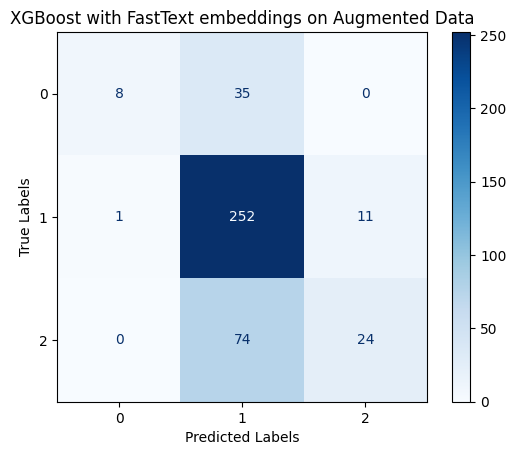

In [ ]:
print("\nClassification Report:\n")
print(classification_report(y_test, y_test_pred, target_names=['class_0', 'class_1', 'class_2']))

# Confusion matrix
cm = confusion_matrix(y_test, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=np.unique(y_test))
disp.plot(cmap=plt.cm.Blues)

plt.title('XGBoost with FastText embeddings on Augmented Data')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

plt.show()

In [ ]:
pip install shap

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.1/540.1 kB 27.3 MB/s eta 0:00:00


In [ ]:
import openai
import pandas as pd
import numpy as np
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator, TransformerMixin
import shap


def get_embedding(text, model="text-embedding-3-large"):
    text = text.replace("\n", " ")
    response = openai.Embedding.create(input=[text], model=model)
    return response['data'][0]['embedding']

class OpenAIEmbeddingTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, model="text-embedding-3-large"):
        self.model = model  # Model to use for embeddings

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        return np.array([self.get_openai_embedding(text) for text in X])

    def get_openai_embedding(self, text):
        return get_embedding(text, self.model)

embedding_transformer = OpenAIEmbeddingTransformer()

pipeline = Pipeline([
    ('embedding', embedding_transformer),  # Embedding step
    ('classifier', final_model)  # Classifier step
])

masker = shap.maskers.Text()
explainer = shap.Explainer(pipeline.predict_proba, masker=masker)

indices = [21, 32, 35, 90, 106, 120, 136, 138, 140, 141]

selected_texts = [text_encoded['test']['text'][i] for i in indices]


shap_values = explainer(selected_texts)

custom_labels = ["Unclassified, 1-star and 2-star", "3-star", "4-star"]
shap_values.output_names = custom_labels

shap.plots.text(shap_values[0])

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|█         | 1/10 [00:00<?, ?it/s]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|███       | 3/10 [08:56<15:25, 132.26s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|████      | 4/10 [13:27<19:01, 190.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|█████     | 5/10 [18:02<18:29, 221.99s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|██████    | 6/10 [22:19<15:36, 234.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|███████   | 7/10 [26:44<12:13, 244.36s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|████████  | 8/10 [31:15<08:25, 252.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|█████████ | 9/10 [35:59<04:22, 262.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 100%|██████████| 10/10 [40:25<00:00, 263.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 11it [45:01, 270.12s/it]


In [ ]:
shap.plots.text(shap_values[5])

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator, TransformerMixin
import numpy as np
import torch
from transformers import LongformerModel, LongformerTokenizer
import shap

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = LongformerModel.from_pretrained('allenai/longformer-base-4096').to(device)
tokenizer = LongformerTokenizer.from_pretrained('allenai/longformer-base-4096')

class EmbeddingTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, model, tokenizer, device=device, max_length=4096):
        self.model = model  # Pass the Longformer model
        self.tokenizer = tokenizer  # Pass the Longformer tokenizer
        self.device = device  # Specify the device (CPU or GPU)
        self.max_length = max_length  # Max length for tokenization

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        # Convert raw text to Longformer embeddings
        return np.array([self.get_longformer_embeddings(text) for text in X])

    def get_longformer_embeddings(self, text):
        # Tokenize the text using LongformerTokenizer and convert it to embeddings
        inputs = self.tokenizer(text, return_tensors="pt", max_length=self.max_length, truncation=True, padding=True)
        inputs = {key: value.to(self.device) for key, value in inputs.items()}

        with torch.no_grad():
            outputs = self.model(**inputs)

        # Take the mean of the last hidden state to obtain the sentence embedding
        embeddings = outputs.last_hidden_state.mean(dim=1)
        return embeddings.squeeze().cpu().numpy()

embedding_transformer = EmbeddingTransformer(model=model, tokenizer=tokenizer)

pipeline = Pipeline([
    ('embedding', embedding_transformer),
    ('classifier', final_model)

masker = shap.maskers.Text()
explainer = shap.Explainer(pipeline.predict_proba, masker=masker)

indices = [21, 32, 35, 90, 106, 120, 136, 138, 140, 141]
selected_texts = [text_encoded['test']['text'][i] for i in indices]  # Assuming text_encoded['test']['text'] is a list of texts

shap_values = explainer(selected_texts)

custom_labels = ["Unclassified, 1-star and 2-star", "3-star", "4-star"]
shap_values.output_names = custom_labels

shap.plots.text(shap_values[0])

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|█         | 1/10 [00:00<?, ?it/s]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|███       | 3/10 [01:01<01:38, 14.03s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|████      | 4/10 [01:27<01:52, 18.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|█████     | 5/10 [01:53<01:46, 21.37s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|██████    | 6/10 [02:15<01:26, 21.67s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|███████   | 7/10 [02:37<01:05, 21.80s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|████████  | 8/10 [03:02<00:45, 22.75s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|█████████ | 9/10 [03:36<00:26, 26.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 100%|██████████| 10/10 [03:59<00:00, 25.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 11it [04:23, 26.38s/it]


In [ ]:
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
import numpy as np
import nltk
import shap

nltk.download('punkt')

class EmbeddingTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, model):
        self.model = model  # Pass the embedding model (e.g., FastText)

    def fit(elf, X, y=None):
        return self

    def transform(self, X):
        return np.array([self.text_to_embedding(self.tokenize(text)) for text in X])

    def tokenize(self, text):
        return nltk.word_tokenize(text)

    def text_to_embedding(self, tokens):
        embeddings = [self.model[word] for word in tokens if word in self.model]
        if len(embeddings) == 0:
            return np.zeros(self.model.vector_size)  # Return a zero vector if no valid words
        return np.mean(embeddings, axis=0)

embedding_transformer = EmbeddingTransformer(model=fasttext_model)

pipeline = Pipeline([
    ('embedding', embedding_transformer),
    ('classifier', final_model)

masker = shap.maskers.Text()

explainer = shap.Explainer(pipeline.predict_proba, masker=masker)
indices = [21, 32, 35, 90, 106, 120, 136, 138, 140, 141]

selected_texts = [text_encoded['test']['text'][i] for i in indices]

text = preprocess_text(text)

def flatten(sents_tokenized):
    return [word for sentence in sents_tokenized for word in sentence]

def tokens_to_string(tokens):
    return ' '.join(tokens)

selected_texts = [preprocess_text(text_encoded['test']['text'][i]) for i in indices]

def flatten(sents_tokenized):
    """Flatten a list of tokenized sentences into a single list of words."""
    return [word for sentence in sents_tokenized for word in sentence]

def tokens_to_string(tokens):
    """Convert a list of tokens into a single string."""
    return ' '.join(tokens)

# Applying the functions to preprocess and flatten the selected texts
processed_flattened_texts = [tokens_to_string(flatten(text)) for text in selected_texts]


shap_values = explainer(processed_flattened_texts)


custom_labels = ["Unclassified, 1-star and 2-star", "3-star", "4-star"]
shap_values.output_names = custom_labels

# Visualize SHAP values for the first instance
shap.plots.text(shap_values[0])


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
PartitionExplainer explainer: 11it [00:28,  4.09s/it]


In [ ]:
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
import numpy as np
import nltk
import shap

nltk.download('punkt')

class EmbeddingTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, model):
        self.model = model

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        return np.array([self.text_to_embedding(self.tokenize(text)) for text in X])

    def tokenize(self, text):
        return nltk.word_tokenize(text)

    def text_to_embedding(self, tokens):
        embeddings = [self.model[word] for word in tokens if word in self.model]
        if len(embeddings) == 0:
            return np.zeros(self.model.vector_size)
        return np.mean(embeddings, axis=0)

embedding_transformer = EmbeddingTransformer(model=fasttext_model)

pipeline = Pipeline([
    ('embedding', embedding_transformer),
    ('classifier', final_model)
])

masker = shap.maskers.Text()

explainer = shap.Explainer(pipeline.predict_proba, masker=masker)
indices = [21, 32, 35, 90, 106, 120, 136, 138, 140, 141]

selected_texts = [text_encoded['test']['text'][i] for i in indices]

text = preprocess_text(text)

def flatten(sents_tokenized):
    return [word for sentence in sents_tokenized for word in sentence]

def tokens_to_string(tokens):
    return ' '.join(tokens)

selected_texts = [preprocess_text(text_encoded['test']['text'][i]) for i in indices]

def flatten(sents_tokenized):
    """Flatten a list of tokenized sentences into a single list of words."""
    return [word for sentence in sents_tokenized for word in sentence]

def tokens_to_string(tokens):
    """Convert a list of tokens into a single string."""
    return ' '.join(tokens)

processed_flattened_texts = [tokens_to_string(flatten(text)) for text in selected_texts]


shap_values = explainer(processed_flattened_texts)


custom_labels = ["Unclassified, 1-star and 2-star", "3-star", "4-star"]
shap_values.output_names = custom_labels

# Visualize SHAP values for the first instance
shap.plots.text(shap_values[0])

In [ ]:

shap.plots.text(shap_values[6])

In [ ]:
import pandas as pd
import datasets
from transformers import BertTokenizerFast, BertForSequenceClassification, Trainer, TrainingArguments
import torch.nn as nn
import torch
from torch.utils.data import Dataset, DataLoader
import numpy as np
from sklearn.metrics import accuracy_score, precision_recall_fscore_support
from tqdm import tqdm
import os
from transformers import DistilBertTokenizerFast, DistilBertForSequenceClassification
import torch
from transformers import BertTokenizerFast, BertForSequenceClassification, Trainer, TrainingArguments

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

tokenizer = BertTokenizerFast.from_pretrained('bert-base-uncased')

def tokenization(batched_text):
    return tokenizer(batched_text['text'], padding = 'max_length', truncation=True)

text_encoded = dataset_dict.map(tokenization, batched=True, batch_size=None)

text_encoded.set_format("torch", columns=["input_ids", "attention_mask", "label"])

Using device: cuda


Map:   0%|          | 0/1395 [00:00<?, ? examples/s]

Map:   0%|          | 0/203 [00:00<?, ? examples/s]

Map:   0%|          | 0/202 [00:00<?, ? examples/s]

In [ ]:

def compute_metrics(pred):
    labels = pred.label_ids
    preds = np.argmax(pred.predictions, axis=1)

    precision, recall, f1, _ = precision_recall_fscore_support(
        labels, preds, average='macro', zero_division=0
    )

    acc = accuracy_score(labels, preds)

    return {
        'accuracy': acc,
        'f1': f1,
        'precision': precision,
        'recall': recall
    }

In [ ]:
text_encoded

DatasetDict({
    train: Dataset({
        features: ['text', 'label', '__index_level_0__', 'input_ids', 'token_type_ids', 'attention_mask'],
        num_rows: 1395
    })
    test: Dataset({
        features: ['text', 'label', '__index_level_0__', 'input_ids', 'token_type_ids', 'attention_mask'],
        num_rows: 203
    })
    validation: Dataset({
        features: ['text', 'label', '__index_level_0__', 'input_ids', 'token_type_ids', 'attention_mask'],
        num_rows: 202
    })
})

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import torch
from transformers import Trainer, TrainingArguments, BertForSequenceClassification
from itertools import product
from sklearn.metrics import precision_recall_fscore_support, accuracy_score
import numpy as np

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=3)


per_gpu_batch_size = 8
learning_rate = 5e-05
num_epochs = 4
weight_decay = 0.001
warmup_steps = 200

model.to(device)

=training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=num_epochs,
    per_device_train_batch_size=per_gpu_batch_size,
    evaluation_strategy="epoch",
    save_strategy="no",
    fp16=True,
    gradient_accumulation_steps=4,
    logging_dir='./logs',
    logging_steps=10,
    report_to="none",
    warmup_steps=warmup_steps,
)

def compute_metrics(eval_pred):
    predictions, labels = eval_pred
    preds = np.argmax(predictions, axis=1)
    precision, recall, f1, _ = precision_recall_fscore_support(labels, preds, average='macro')
    acc = accuracy_score(labels, preds)
    return {
        'accuracy': acc,
        'f1': f1,
        'precision': precision,
        'recall': recall
    }

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=text_encoded['train'],
    eval_dataset=text_encoded['validation'],
    compute_metrics=compute_metrics
)

trainer.train()

eval_result = trainer.evaluate()

print(eval_result)


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
0,1.057300,0.966550,0.608911,0.401555,0.379892,0.426829
1,0.967700,0.827348,0.673267,0.483008,0.705719,0.462999
2,0.714300,0.846235,0.594059,0.465726,0.524000,0.471346
3,0.453200,0.878869,0.648515,0.448643,0.644777,0.442054


{'eval_loss': 0.8788694143295288, 'eval_accuracy': 0.6485148514851485, 'eval_f1': 0.44864323736367395, 'eval_precision': 0.6447772657450077, 'eval_recall': 0.44205359831376095, 'eval_runtime': 0.4033, 'eval_samples_per_second': 500.894, 'eval_steps_per_second': 64.472, 'epoch': 3.9314285714285715}


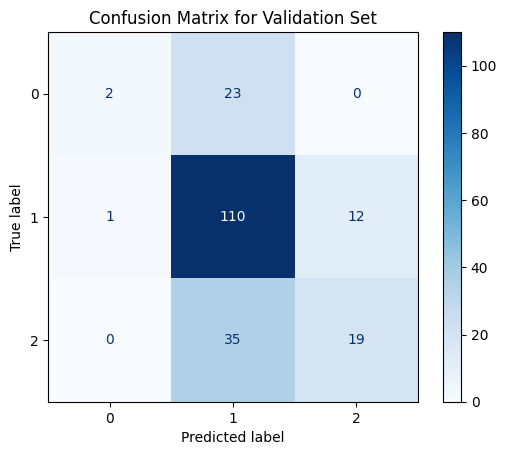

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_fscore_support, accuracy_score, confusion_matrix, ConfusionMatrixDisplay

predictions, labels, _ = trainer.predict(text_encoded['validation'])
preds = np.argmax(predictions, axis=1)

cm = confusion_matrix(labels, preds)

disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)

plt.title('Confusion Matrix for Validation Set')

plt.show()

In [ ]:
report = classification_report(labels, preds, target_names=['Class 0', 'Class 1', 'Class 2'])
print(report)

              precision    recall  f1-score   support

     Class 0       0.67      0.08      0.14        25
     Class 1       0.65      0.89      0.76       123
     Class 2       0.61      0.35      0.45        54

    accuracy                           0.65       202
   macro avg       0.64      0.44      0.45       202
weighted avg       0.65      0.65      0.60       202



In [ ]:
import numpy as np
import torch
from sklearn.metrics import precision_recall_fscore_support, accuracy_score
from transformers import Trainer, TrainingArguments, LongformerForSequenceClassification
import optuna
from transformers import EarlyStoppingCallback

shuffled_dataset = text_encoded.shuffle(seed=42)

def compute_metrics(pred):
    labels = pred.label_ids
    preds = np.argmax(pred.predictions, axis=1)

    precision, recall, f1, _ = precision_recall_fscore_support(
        labels, preds, average='macro', zero_division=0
    )

    acc = accuracy_score(labels, preds)

    return {
        'accuracy': acc,
        'f1': f1,
        'precision': precision,
        'recall': recall
    }

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

best_f1_macro = 0
best_model_path = './best_bert_model'  # Directory to save the best model

def objective(trial):

    global best_f1_macro


    model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=3).to(device)


    per_gpu_batch_size = trial.suggest_int('per_gpu_batch_size', 2, 4)
    learning_rate = trial.suggest_categorical('learning_rate', [2e-5, 3e-5, 5e-5])
    num_epochs = trial.suggest_categorical('num_epochs', [2, 3, 4])
    weight_decay = trial.suggest_uniform('weight_decay', 0, 0.6)
    warmup_steps = trial.suggest_int('warmup_steps', 0, 500)

    training_args = TrainingArguments(
    output_dir='./temp_results',
    num_train_epochs=num_epochs,
    per_device_train_batch_size=per_gpu_batch_size,
    evaluation_strategy="epoch",  # Evaluate after each epoch
    save_strategy="epoch",  # Save model after each evaluation
    metric_for_best_model="f1",  # Use F1 macro score to determine best model
    greater_is_better=True,  # Higher F1 is better
    fp16=True,
    gradient_accumulation_steps=4,
    save_total_limit=2,
    learning_rate=learning_rate,
    weight_decay=weight_decay,
    logging_dir='./temp_logs',
    logging_steps=10,
    report_to="none",
    warmup_steps=warmup_steps
)

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=text_encoded['train'],  # Assuming text_encoded is predefined
        eval_dataset=text_encoded['validation'],
        compute_metrics=compute_metrics,
    )

    trainer.train()

    eval_result = trainer.evaluate()

    f1_macro = eval_result['eval_f1']

    if f1_macro > best_f1_macro:
        print(f"New best model found with F1 macro: {f1_macro}. Saving model...")
        best_f1_macro = f1_macro
        trainer.save_model(best_model_path)

    return f1_macro

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=30)  # Increase the number of trials for a more thorough search

print("Best hyperparameters found: ", study.best_params)

print("Best trial's F1 macro score: ", study.best_value)

print(f"The best model is saved at {best_model_path}")

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
0,1.000000,0.928982,0.534653,0.372449,0.352806,0.424270


[W 2024-09-12 22:06:03,927] Trial 25 failed with parameters: {'per_gpu_batch_size': 3, 'learning_rate': 2e-05, 'num_epochs': 4, 'weight_decay': 0.01271582944006544, 'warmup_steps': 278} because of the following error: KeyboardInterrupt().
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/optuna/study/_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
  File "<ipython-input-352-60fdb5b75480>", line 83, in objective
    trainer.train()
  File "/usr/local/lib/python3.10/dist-packages/transformers/trainer.py", line 1938, in train
    return inner_training_loop(
  File "/usr/local/lib/python3.10/dist-packages/transformers/trainer.py", line 2279, in _inner_training_loop
    tr_loss_step = self.training_step(model, inputs)
  File "/usr/local/lib/python3.10/dist-packages/transformers/trainer.py", line 3318, in training_step
    loss = self.compute_loss(model, inputs)
  File "/usr/local/lib/python3.10/dist-packages/transformers/trainer.py",

KeyboardInterrupt: 

In [ ]:
import os
import numpy as np
import torch
from transformers import Trainer, BertForSequenceClassification
from sklearn.metrics import confusion_matrix, precision_recall_fscore_support, accuracy_score
from transformers import TrainingArguments

# Check if a CUDA device is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Path to the saved model
best_model_path = './best_bert_model'

# Check if the best model has already been saved
if os.path.exists(best_model_path):
    print(f"Loading the best model from {best_model_path}...")
    model = BertForSequenceClassification.from_pretrained(best_model_path).to(device)
else:
    raise ValueError(f"Model not found at {best_model_path}. Please check the path.")

# Define a function to compute metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = np.argmax(pred.predictions, axis=1)

    # Calculate precision, recall, f1 using macro average
    precision, recall, f1, _ = precision_recall_fscore_support(
        labels, preds, average='macro', zero_division=0
    )

    # Calculate accuracy
    acc = accuracy_score(labels, preds)

    # Return metrics as a dictionary
    return {
        'accuracy': acc,
        'f1': f1,
        'precision': precision,
        'recall': recall
    }

# Assume `text_encoded['test']` is your DatasetDict with the test set
test_dataset = text_encoded['test']  # Use the testing set

# Define the training arguments (for evaluation, no retraining)
training_args = TrainingArguments(
    output_dir='./temp_results',
    per_device_eval_batch_size=2,  # Batch size for evaluation
    report_to="none",
    fp16=True
)

# Initialize the Trainer for evaluation
trainer = Trainer(
    model=model,
    args=training_args,
    compute_metrics=compute_metrics
)

# Make predictions on the test set
predictions = trainer.predict(test_dataset)

# Get the predicted labels and true labels
preds = np.argmax(predictions.predictions, axis=1)
true_labels = predictions.label_ids

# Compute the confusion matrix for the test set
conf_matrix = confusion_matrix(true_labels, preds)

print("Confusion Matrix for the Test Set:")
print(conf_matrix)

Loading the best model from ./best_bert_model...


Confusion Matrix for the Test Set:
[[10  6  2]
 [20 86 35]
 [ 2 26 16]]


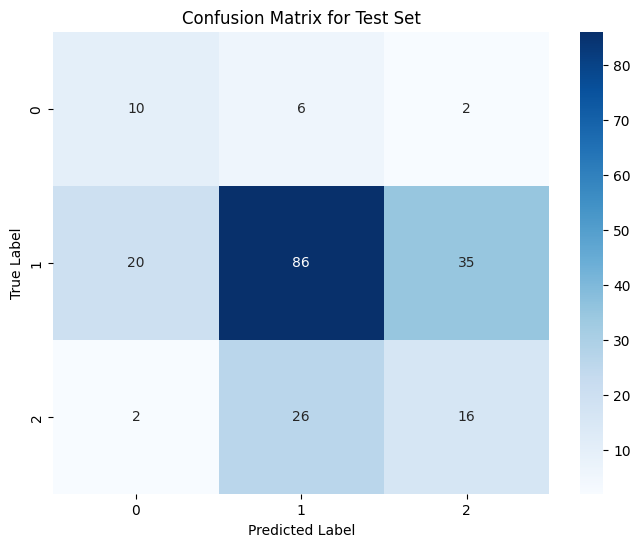

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.31      0.56      0.40        18
     Class 1       0.73      0.61      0.66       141
     Class 2       0.30      0.36      0.33        44

    accuracy                           0.55       203
   macro avg       0.45      0.51      0.46       203
weighted avg       0.60      0.55      0.57       203



In [ ]:
predictions = trainer.predict(test_dataset)

preds = np.argmax(predictions.predictions, axis=1)
true_labels = predictions.label_ids

conf_matrix = confusion_matrix(true_labels, preds)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=[0, 1, 2], yticklabels=[0, 1, 2])
plt.title("Confusion Matrix for Test Set")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

class_report = classification_report(true_labels, preds, target_names=['Class 0', 'Class 1', 'Class 2'])

print("Classification Report:")
print(class_report)

In [ ]:
import numpy as np
import torch
from sklearn.metrics import precision_recall_fscore_support, accuracy_score
from transformers import Trainer, TrainingArguments, BertForSequenceClassification

shuffled_dataset = text_encoded.shuffle(seed=42)

def compute_metrics(pred):
    labels = pred.label_ids
    preds = np.argmax(pred.predictions, axis=1)

    precision, recall, f1, _ = precision_recall_fscore_support(
        labels, preds, average='macro', zero_division=0
    )

    acc = accuracy_score(labels, preds)

    return {
        'accuracy': acc,
        'f1': f1,
        'precision': precision,
        'recall': recall
    }

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

per_gpu_batch_size = 4
learning_rate = 3e-5
num_epochs = 2
weight_decay = 0.01
warmup_steps = 100

model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=3).to(device)

training_args = TrainingArguments(
    output_dir='./temp_results',
    num_train_epochs=num_epochs,
    per_device_train_batch_size=per_gpu_batch_size,
    evaluation_strategy="epoch",
    save_strategy="epoch",
    metric_for_best_model="f1",
    greater_is_better=True,
    fp16=True,
    gradient_accumulation_steps=4,
    save_total_limit=2,
    learning_rate=learning_rate,
    weight_decay=weight_decay,
    logging_dir='./temp_logs',
    logging_steps=10,
    report_to="none",
    warmup_steps=warmup_steps
)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=text_encoded['train'],   # Use validation dataset
    compute_metrics=compute_metrics,
)

trainer.train()

eval_result = trainer.evaluate()

print(f"Evaluation Results: {eval_result}")

best_model_path = './best_bert_model'
trainer.save_model(best_model_path)
print(f"Model saved at {best_model_path}")

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
0,0.964400,0.863958,0.633663,0.503377,0.570048,0.494435
1,0.706200,0.797026,0.628713,0.564835,0.559027,0.571840


Evaluation Results: {'eval_loss': 0.7970260977745056, 'eval_accuracy': 0.6287128712871287, 'eval_f1': 0.5648351648351648, 'eval_precision': 0.5590267544290533, 'eval_recall': 0.5718398072869618, 'eval_runtime': 0.4125, 'eval_samples_per_second': 489.733, 'eval_steps_per_second': 63.035, 'epoch': 1.994269340974212}
Model saved at ./best_bert_model


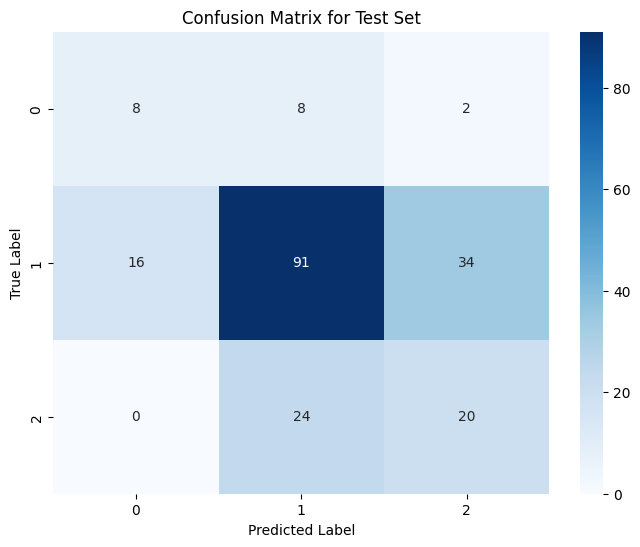

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.33      0.44      0.38        18
     Class 1       0.74      0.65      0.69       141
     Class 2       0.36      0.45      0.40        44

    accuracy                           0.59       203
   macro avg       0.48      0.51      0.49       203
weighted avg       0.62      0.59      0.60       203



In [ ]:
predictions = trainer.predict(test_dataset)

# Get the predicted labels and true labels
preds = np.argmax(predictions.predictions, axis=1)
true_labels = predictions.label_ids

# Compute the confusion matrix for the test set
conf_matrix = confusion_matrix(true_labels, preds)

# Plot confusion matrix using seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=[0, 1, 2], yticklabels=[0, 1, 2])
plt.title("Confusion Matrix for Test Set")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

# Get the classification report
class_report = classification_report(true_labels, preds, target_names=['Class 0', 'Class 1', 'Class 2'])

print("Classification Report:")
print(class_report)

In [ ]:
import shap
from transformers import pipeline

def tokenization(batched_text):
    return tokenizer(batched_text['text'], padding = 'max_length', truncation=True)

model_path = "/content/drive/MyDrive/MDS project/best_bert_model"

model = BertForSequenceClassification.from_pretrained(model_path)

tokenizer = BertTokenizerFast.from_pretrained('bert-base-uncased')

classifier = pipeline('text-classification', return_all_scores=True, model=model,tokenizer=tokenizer, device=0 )


In [ ]:

classifier

explainer = shap.Explainer(classifier)



In [ ]:
texts = [tokenizer.decode(tokenizer.encode(text, truncation=True, max_length=512)[1:], skip_special_tokens=True)
         for text in subset["text"]]

texts[5]

'pharm2farm ltd. has commercialised ntu\'s patented technologies, created jobs, attracted investment, and significant growth led to the company\'s £2. 37 million acquisition. pharm2farm ltd. was incorporated as an ntu spin - out company in august 2015. it has licenced gareth cave\'s granted patents and is commercialising cave\'s groundbreaking research innovations in nanoparticle biofortification and virucides, including nanoparticle fabrication techniques that reduced the cost of nanoparticle production from over £1000 per kilogram to [ text removed for publication ] per kilogram, making volume production possible. pharm2farm ltd. adopted, further developed, and scaled up cave\'s novel coated nanoparticle manufacture techniques and brought to market a range of commercial " nano plant fertiliser " plant feed products based on this technology. these plant feed products, which have been sold and supplied globally, include own brands seasons and spectrum™, and nanoparticles supplied as ac

In [ ]:
shap_values = explainer(texts)

shap_values

  0%|          | 0/498 [00:00<?, ?it/s]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  20%|██        | 2/10 [00:00<?, ?it/s]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|████      | 4/10 [00:24<00:24,  4.13s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|█████     | 5/10 [00:32<00:29,  5.83s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|██████    | 6/10 [00:41<00:26,  6.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|███████   | 7/10 [00:49<00:21,  7.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|████████  | 8/10 [00:57<00:14,  7.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|█████████ | 9/10 [01:05<00:07,  7.70s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 100%|██████████| 10/10 [01:13<00:00,  7.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 11it [01:21,  9.07s/it]


.values =
array([[[-1.76529940e-04,  7.07578017e-04, -5.31048954e-04],
        [-1.76529940e-04,  7.07578017e-04, -5.31048954e-04],
        [-1.76529940e-04,  7.07578017e-04, -5.31048954e-04],
        ...,
        [ 2.36660762e-03, -1.34485774e-04, -2.23212096e-03],
        [ 2.36660762e-03, -1.34485774e-04, -2.23212096e-03],
        [ 2.36660762e-03, -1.34485774e-04, -2.23212096e-03]],

       [[-5.96121299e-04,  4.08218865e-04,  1.87903217e-04],
        [-5.96121299e-04,  4.08218865e-04,  1.87903217e-04],
        [-5.96121299e-04,  4.08218865e-04,  1.87903217e-04],
        ...,
        [-2.89091918e-03,  5.48054992e-04,  2.34286464e-03],
        [-2.89091918e-03,  5.48054992e-04,  2.34286464e-03],
        [-2.89091918e-03,  5.48054992e-04,  2.34286464e-03]],

       [[ 6.30034372e-04, -1.74549043e-04, -4.55485474e-04],
        [ 6.30034372e-04, -1.74549043e-04, -4.55485474e-04],
        [ 6.30034372e-04, -1.74549043e-04, -4.55485474e-04],
        ...,
        [ 5.65513423e-04,  3.732

In [ ]:
custom_labels = ["Unclassified, 1-star and 2-star", "3-star", "4-star"]
shap_values.output_names = custom_labels

shap.plots.text(shap_values[6])

In [ ]:
testing_set

,Main panel_x,Unit of assessment number_x,Title,cleaned text,5 Class Labels,Summary impact type,9 Class Labels,Variance,sentence tokenized,word tokenized,string,3 Class Labels,gpt_embedding,Assigned_Topic
0,A,2.0,Development and implementation of UK tobacco c...,Smoking is the largest avoidable cause of deat...,4,Health,8,0.000000,"[['smoking', 'large', 'avoidable', 'cause', 'd...","['smoking', 'large', 'avoidable', 'cause', 'de...",smoking large avoidable cause death disability...,2,"[0.054960548877716064, 0.005253832787275314, -...",26
1,A,2.0,Radical reorganisation of trauma services redu...,"In the UK, prior to 2012, major trauma patient...",3,Health,7,0.801551,"[['prior', 'major', 'trauma', 'patient', 'inva...","['prior', 'major', 'trauma', 'patient', 'invar...",prior major trauma patient invariably take nea...,1,"[0.03313501179218292, 0.025889569893479347, -0...",7
2,A,4.0,Imaging-based diagnostics for patient selectio...,The benefit of thrombolytic therapy for AIS is...,4,Health,7,0.250000,"[['benefit', 'thrombolytic', 'therapy', 'well'...","['benefit', 'thrombolytic', 'therapy', 'well',...",benefit thrombolytic therapy well established ...,1,"[0.013433797284960747, 0.03742389753460884, -0...",28
3,A,3.0,eLearning for safer prescribing practice,We have developed and nationally disseminated ...,3,Societal,7,0.234375,"[['develop', 'nationally', 'disseminate', 'ele...","['develop', 'nationally', 'disseminate', 'elec...",develop nationally disseminate electronic educ...,1,"[-0.0007114423206076026, 0.027826989069581032,...",9
4,A,6.0,Reducing Food Waste by Controlling Ethylene,UN Sustainable Development Goal 12.3 aims to r...,4,Technological,8,0.187500,"[['sustainable', 'development', 'goal'], ['aim...","['sustainable', 'development', 'goal', 'aim', ...",sustainable development goal aim reduce food l...,2,"[-0.015000398270785809, 0.04113832488656044, -...",14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
400,A,4.0,Do Something Different: achieving positive beh...,The research-based Do Something Different beha...,4,Societal,8,0.000000,"[['researchbased', 'something', 'different', '...","['researchbased', 'something', 'different', 'b...",researchbased something different behavioural ...,2,"[0.003964405041188002, 0.026906108483672142, -...",0
401,A,2.0,Raising the international quality of osteoarth...,We extended understanding of osteoarthritis an...,3,Health,7,0.222111,"[['extend', 'understanding', 'osteoarthritis',...","['extend', 'understanding', 'osteoarthritis', ...",extend understanding osteoarthritis influence ...,1,"[0.01031201146543026, 0.020187312737107277, -0...",22
402,A,5.0,Antimicrobial materials: better outcomes for o...,Increasing the range of antibiotics used in PM...,2,Health,5,0.250000,"[['increase', 'range', 'antibiotic', 'use', 'p...","['increase', 'range', 'antibiotic', 'use', 'pm...",increase range antibiotic use pmma bone cement...,0,"[-0.0011697604786604643, 0.031477190554142, -0...",21
403,A,3.0,Bridges: advancing the spread of self-manageme...,Development of the Bridges self-management pro...,3,Health,6,0.454204,"[['development', 'bridge', 'selfmanagement', '...","['development', 'bridge', 'selfmanagement', 'p...",development bridge selfmanagement programme be...,1,"[0.012867392040789127, 0.04787344112992287, -0...",29
